In [1]:
pip install folium

Note: you may need to restart the kernel to use updated packages.


In [44]:
import json
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

# Load JSON data
with open('G:/IISc Bangalore/IUDX/traffic_violations1.json', 'r') as f:
    data = json.load(f)

# Convert JSON to DataFrame
df = pd.DataFrame(data)

# Write DataFrame to CSV
df.to_csv('traffic_events.csv', index=False)

print("CSV file created successfully.")

CSV file created successfully.


In [45]:
df = pd.json_normalize(data)
df.head(5)

,id,vehicleType,alertType,observationDateTime,cameraUsage,junctionName,location.type,location.coordinates
0,5b778007-797e-4313-b34c-c7c4812365bb,Car,STOP_LINE_VIOLATION,2024-02-21T13:29:49+05:30,ANPR,SampigeRoad,Point,"[77.571138, 13.008491]"
1,5b778007-797e-4313-b34c-c7c4812365bb,Car,LICENCE_PLATE_RECOGNITION,2024-02-21T13:30:00+05:30,ANPR,VanivilasJN,Point,"[77.576809, 12.948272]"
2,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,STOP_LINE_VIOLATION,2024-02-21T13:30:00+05:30,ANPR,Mariyappacircle,Point,"[77.63721, 13.022783]"
3,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,RED_LIGHT_VIOLATION_DETECTION,2024-02-21T13:29:59+05:30,ANPR,Mariyappacircle,Point,"[77.63721, 13.022783]"
4,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,RED_LIGHT_VIOLATION_DETECTION,2024-02-21T13:10:36+05:30,ANPR,Chindrikahotel,Point,"[77.593048, 12.989344]"


In [46]:
df.tail(5)

,id,vehicleType,alertType,observationDateTime,cameraUsage,junctionName,location.type,location.coordinates
4753001,5b778007-797e-4313-b34c-c7c4812365bb,Car,RED_LIGHT_VIOLATION_DETECTION,2024-03-20T22:29:44+05:30,ANPR,SwamiVivekananda,Point,"[77.631421, 12.981592]"
4753002,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,STOP_LINE_VIOLATION,2024-03-20T22:29:43+05:30,ANPR,JPnagar-8thmain-9thcross,Point,"[77.595183, 12.910289]"
4753003,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,RED_LIGHT_VIOLATION_DETECTION,2024-03-20T22:29:42+05:30,ANPR,AXASignal,Point,"[77.615204, 12.91602]"
4753004,5b778007-797e-4313-b34c-c7c4812365bb,Undetermined,RED_LIGHT_VIOLATION_DETECTION,2024-03-20T22:29:41+05:30,ANPR,AXASignal,Point,"[77.615204, 12.91602]"
4753005,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,STOP_LINE_VIOLATION,2024-03-20T22:29:40+05:30,ANPR,Jayanagar-4thMain,Point,"[77.580123, 12.930848]"


Hence the timeframe considered for the study is **21-02-2024 to 20-03-2024**

In [47]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4753006 entries, 0 to 4753005
Data columns (total 8 columns):
 #   Column                Dtype 
---  ------                ----- 
 0   id                    object
 1   vehicleType           object
 2   alertType             object
 3   observationDateTime   object
 4   cameraUsage           object
 5   junctionName          object
 6   location.type         object
 7   location.coordinates  object
dtypes: object(8)
memory usage: 290.1+ MB
None


In [48]:
filtered_df = df[~df['alertType'].isin(['LICENCE_PLATE_RECOGNITION', 'RED_LIGHT', 'GREEN_LIGHT'])]
print(filtered_df.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 970645 entries, 0 to 4753005
Data columns (total 8 columns):
 #   Column                Non-Null Count   Dtype 
---  ------                --------------   ----- 
 0   id                    970645 non-null  object
 1   vehicleType           970645 non-null  object
 2   alertType             970645 non-null  object
 3   observationDateTime   970645 non-null  object
 4   cameraUsage           970309 non-null  object
 5   junctionName          970645 non-null  object
 6   location.type         970645 non-null  object
 7   location.coordinates  970645 non-null  object
dtypes: object(8)
memory usage: 66.6+ MB
None


In [49]:
print(filtered_df['location.coordinates'])

0          [77.571138, 13.008491]
2           [77.63721, 13.022783]
3           [77.63721, 13.022783]
4          [77.593048, 12.989344]
5           [77.61448, 12.991661]
                    ...          
4753001    [77.631421, 12.981592]
4753002    [77.595183, 12.910289]
4753003     [77.615204, 12.91602]
4753004     [77.615204, 12.91602]
4753005    [77.580123, 12.930848]
Name: location.coordinates, Length: 970645, dtype: object


In [50]:
unique_coordinates = filtered_df['location.coordinates'].apply(tuple).unique()

In [51]:
print(unique_coordinates)

[(77.571138, 13.008491) (77.63721, 13.022783) (77.593048, 12.989344)
 (77.61448, 12.991661) (77.554162, 12.984416) (77.57275, 13.01463)
 (77.631421, 12.981592) (77.615204, 12.91602) (77.57128, 13.028377)
 (77.643319, 13.009179) (77.59061, 13.010052) (77.553042, 12.998237)
 (77.576809, 12.948272) (77.633651, 12.924831) (77.594711, 12.981865)
 (77.580396, 12.917107) (77.640837, 12.978368) (77.609731, 12.934747)
 (77.580123, 12.930848) (77.591393, 12.953822) (77.704469, 13.017111)
 (77.602438, 12.979232) (77.595183, 12.910289) (77.611378, 12.967623)
 (77.620657, 12.966769) (77.649095, 12.959774) (77.549943, 12.925376)
 (77.646621, 12.978562) (77.57168, 12.960574) (77.578765, 13.006399)
 (77.708519, 13.019476) (0.0, 0.0) (77.607594, 12.944023)
 (77.586068, 12.928639) (77.645087, 12.985709) (77.620982, 12.927565)
 (77.577328, 12.956281) (77.633143, 12.929832) (77.567362, 12.957135)
 (77.592438, 13.020731) (77.638689, 12.960965) (77.641287, 12.970227)
 (77.622682, 12.942536) (77.642785, 13.0

In [52]:
dfx = pd.DataFrame(unique_coordinates)
dfx.to_csv("unique_coordinates.csv", index=False)

In [53]:
import folium


# Calculate the mean coordinates for centering the map
mean_latitude = filtered_df['location.coordinates'].apply(lambda x: x[1]).mean()
mean_longitude = filtered_df['location.coordinates'].apply(lambda x: x[0]).mean()

# Create the map
map_city = folium.Map(location=[mean_latitude, mean_longitude], zoom_start=12)

# Add markers for unique coordinates
for coordinates in unique_coordinates:
    latitude, longitude = coordinates[::-1]  # Swap the order for Folium
    popup_text = filtered_df[filtered_df['location.coordinates'].apply(tuple) == coordinates]['junctionName'].iloc[0]  # Get the corresponding junction name
    folium.Marker(location=[latitude, longitude], popup=popup_text).add_to(map_city)

# Display the map
map_city


In [11]:
map_city.save('marker_map.html')

In [12]:
import folium 
from folium.plugins import HeatMap

filtered_df = df[df['alertType'] != 'LICENCE_PLATE_RECOGNITION']
coordinates = filtered_df['location.coordinates'].apply(lambda x: [x[1], x[0]]).tolist()

map_city = folium.Map(location=[filtered_df['location.coordinates'].apply(lambda x: x[1]).mean(),
                                filtered_df['location.coordinates'].apply(lambda x: x[0]).mean()],
                      zoom_start=12.5)

HeatMap(coordinates).add_to(map_city)

map_city


In [13]:
map_city.save('heatmap.html')


In [14]:
# Filter out events with the alert type 'LICENCE_PLATE_RECOGNITION'
violations_df = df[df['alertType'] != 'LICENCE_PLATE_RECOGNITION']

# Calculate the frequency of all other violations
violation_counts = violations_df['alertType'].value_counts()

# Print the frequency of each violation
print(violation_counts)
print(violation_counts.sum())  

RED_LIGHT_VIOLATION_DETECTION    472861
STOP_LINE_VIOLATION              252120
VEHICLE_WRONG_WAY                124085
NO_HELMET                         72004
NO_SEAT_BELT                      21841
OVER_SPEED                        21802
GREEN_LIGHT                       18241
RED_LIGHT                         18209
WOMEN_SURROUNDED_BY_MEN            5042
DRIVER_ON_CALL                      886
EXPIRED_VEHICLES                      4
Name: alertType, dtype: int64
1007095


In [16]:
import pandas as pd

# Filter out events with the alert type 'LICENCE_PLATE_RECOGNITION'
violations_df = df[df['alertType'] != 'LICENCE_PLATE_RECOGNITION']

# Calculate the frequency of all other violations
violation_counts = violations_df['alertType'].value_counts()

# Create a DataFrame from the frequency counts
violation_table = pd.DataFrame(violation_counts).reset_index()
violation_table.columns = ['Violation Type', 'Frequency']

# Print the tabulated data
print(violation_table)

                   Violation Type  Frequency
0   RED_LIGHT_VIOLATION_DETECTION     472861
1             STOP_LINE_VIOLATION     252120
2               VEHICLE_WRONG_WAY     124085
3                       NO_HELMET      72004
4                    NO_SEAT_BELT      21841
5                      OVER_SPEED      21802
6                     GREEN_LIGHT      18241
7                       RED_LIGHT      18209
8         WOMEN_SURROUNDED_BY_MEN       5042
9                  DRIVER_ON_CALL        886
10               EXPIRED_VEHICLES          4


C:\Users\HP\AppData\Local\Temp\ipykernel_9868\1565318470.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




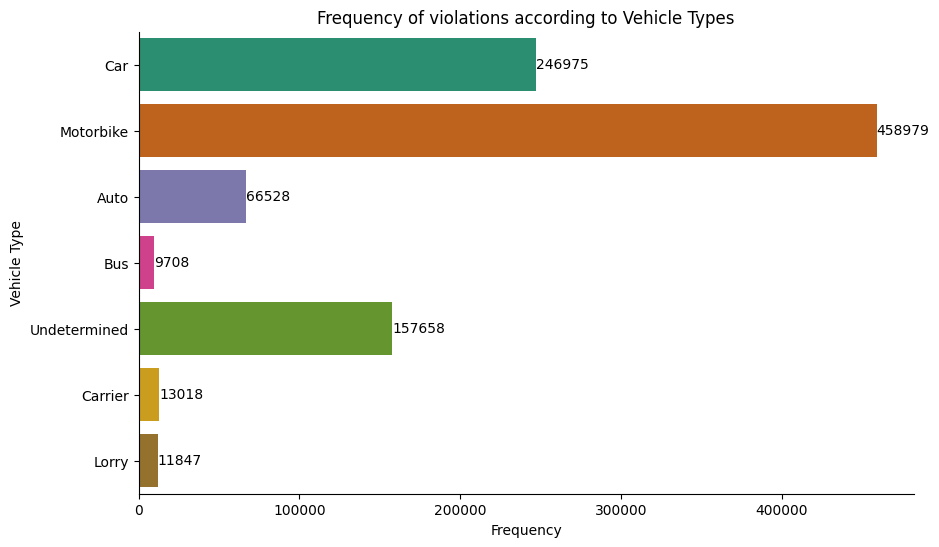

964713


In [32]:
filtered_df = df[~df['alertType'].isin(['LICENCE_PLATE_RECOGNITION', 'RED_LIGHT', 'GREEN_LIGHT', 'WOMEN_SURROUNDED_BY_MEN', 'DRIVER_ON_CALL', 'EXPIRED_VEHICLES'])]

plt.figure(figsize=(10, 6))
ax = sns.countplot(y='vehicleType', data=filtered_df, palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_width())}',
                (p.get_width(), p.get_y() + p.get_height() / 2),
                ha='left', va='center', fontsize=10, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Frequency')
plt.ylabel('Vehicle Type')
plt.title('Frequency of violations according to Vehicle Types')
plt.show()
print(filtered_df['alertType'].value_counts().sum())

In [28]:
!pip install nbformat>=4.2.0
!pip install plotly

In [29]:
import plotly.express as px
import plotly.graph_objects as go

In [30]:
filtered_df = df[df['alertType'] != 'LICENCE_PLATE_RECOGNITION']

# Create the plot
fig = px.histogram(filtered_df, y='vehicleType', color_discrete_sequence=px.colors.qualitative.Dark2)

# Add counts on top of the bars
for data in fig.data:
    data.texttemplate = '%{y}'
    data.textposition = 'outside'
    
fig.update_layout(
    title='Frequency of Vehicle Types (Excluding LICENCE_PLATE_RECOGNITION)',
    xaxis_title='Frequency',
    yaxis_title='Vehicle Type',
    showlegend=False,
    height=600,
    width=800,
    template='plotly_white'
)

fig.show()

# Print the total count of alerts (excluding LICENCE_PLATE_RECOGNITION)
print(filtered_df['alertType'].value_counts().sum())

ValueError: Mime type rendering requires nbformat>=4.2.0 but it is not installed

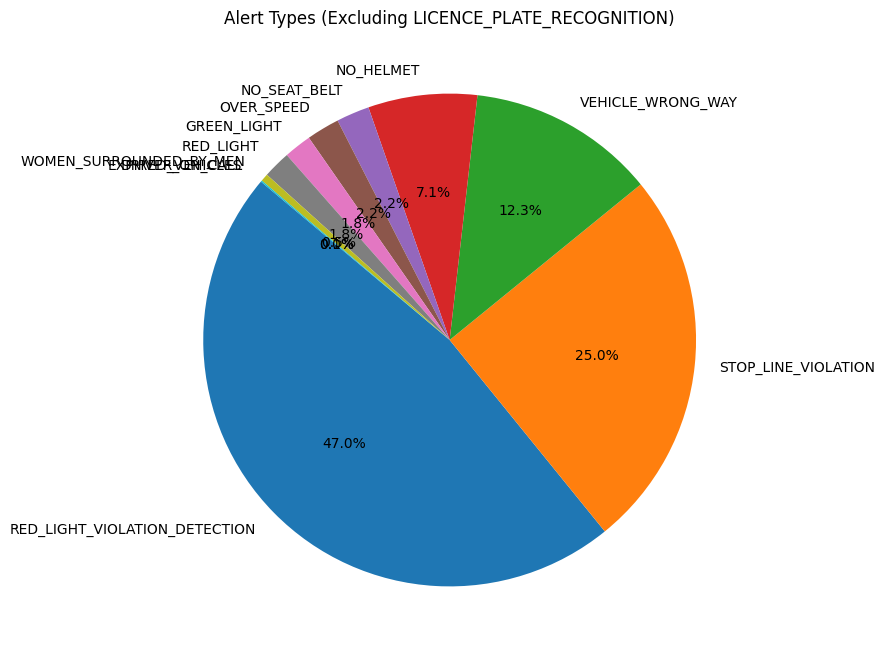

In [18]:
alert_type_counts = filtered_df['alertType'].value_counts()

# Plotting
plt.figure(figsize=(8, 8))
plt.pie(alert_type_counts, labels=alert_type_counts.index, autopct='%1.1f%%', startangle=140)
plt.title('Alert Types (Excluding LICENCE_PLATE_RECOGNITION)')
plt.show()

In [26]:
import plotly.graph_objects as go

# Calculate the frequency of each alert type
alert_type_counts = filtered_df['alertType'].value_counts()

# Create a pie chart figure
fig = go.Figure(data=[go.Pie(labels=alert_type_counts.index, values=alert_type_counts, hole=0.3)])

# Update layout for better aesthetics
fig.update_layout(
    title='Violation Share',
    uniformtext_minsize=12,
    uniformtext_mode='hide',
    showlegend=True
)

# Show the pie chart
fig.show()

In [30]:
import plotly.graph_objects as go

# Calculate the frequency of each alert type
alert_type_counts = filtered_df['alertType'].value_counts()

# Keep only the top 5 most occurring violations
top_5_violations = alert_type_counts.head(6)

# Calculate the sum of frequencies for the remaining violations
other_violations_count = alert_type_counts.iloc[5:].sum()

# Add 'OTHER' category with the sum of frequencies
top_5_violations['OTHER'] = other_violations_count

# Create a pie chart figure
fig = go.Figure(data=[go.Pie(labels=top_5_violations.index, values=top_5_violations, hole=0.3)])

# Update layout for better aesthetics
fig.update_layout(
    title='Key Violation Share',
    uniformtext_minsize=12,
    uniformtext_mode='hide',
    showlegend=True
)

# Show the pie chart
fig.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_9868\2899336749.py:9: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=top_10_junctions.index, y=top_10_junctions.values, palette='Dark2')


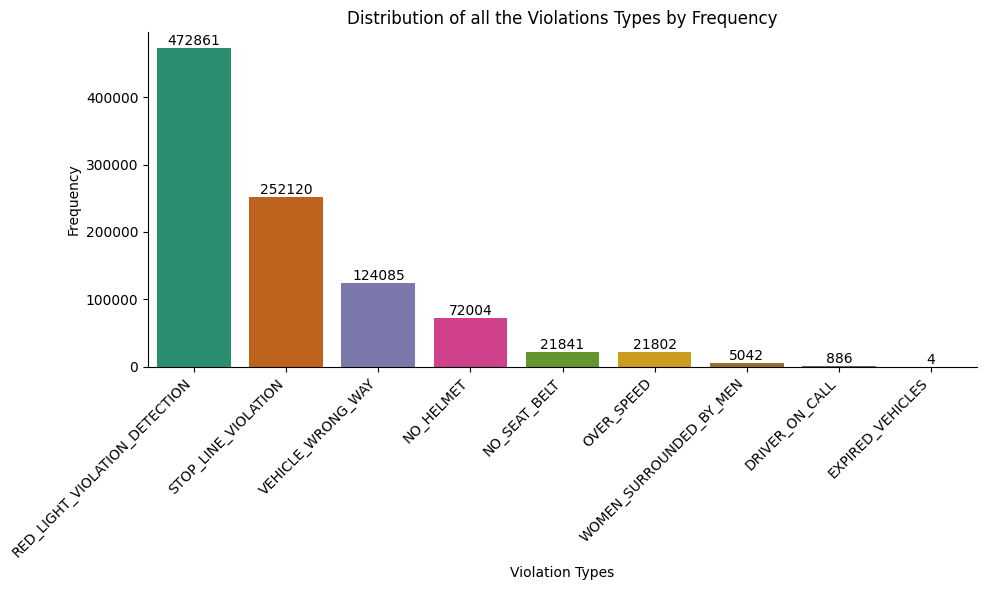

In [21]:
filtered_df = df[~df['alertType'].isin(['LICENCE_PLATE_RECOGNITION', 'RED_LIGHT', 'GREEN_LIGHT'])]
alert_type_counts = filtered_df['alertType'].value_counts()


top_10_junctions = alert_type_counts.head(10)

# Plotting
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=top_10_junctions.index, y=top_10_junctions.values, palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}',
                (p.get_x() + p.get_width() / 2, p.get_height()),
                ha='center', va='bottom', fontsize=10, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Violation Types')
plt.ylabel('Frequency')
plt.title('Distribution of all the Violations Types by Frequency')
plt.xticks(rotation=45, ha='right')  # Rotate x-labels for better readability
plt.tight_layout()
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\297214252.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y='junctionName', data=filtered_df, palette='Dark2')


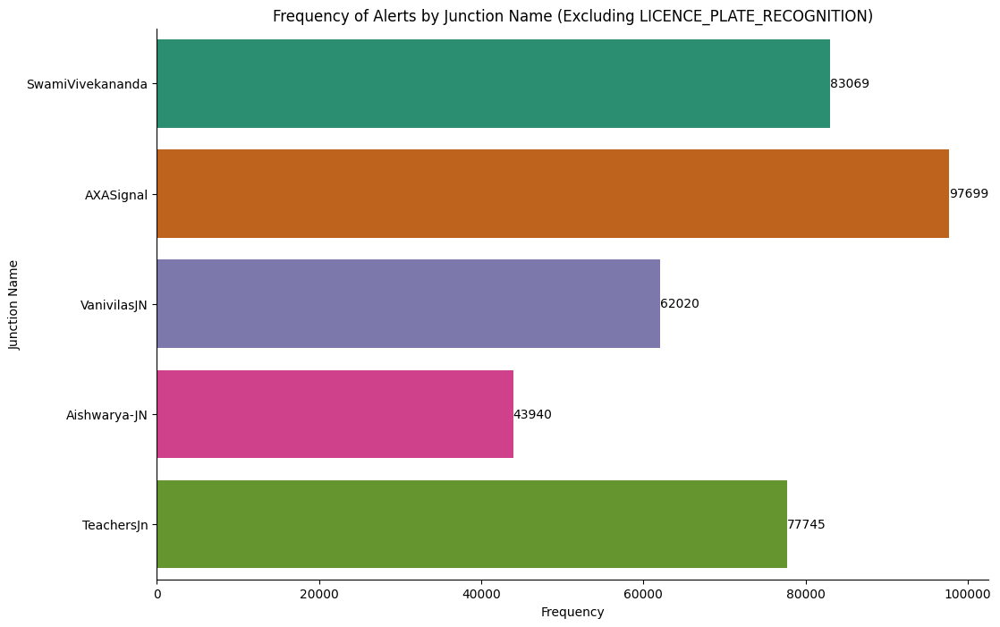

In [28]:
plt.figure(figsize=(12, 8))
ax = sns.countplot(y='junctionName', data=filtered_df, palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_width())}',
                (p.get_width(), p.get_y() + p.get_height() / 2),
                ha='left', va='center', fontsize=10, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Frequency')
plt.ylabel('Junction Name')
plt.title('Frequency of Alerts by Junction Name (Excluding LICENCE_PLATE_RECOGNITION)')
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_9868\4200181721.py:8: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x=top_10_junctions.index, y=top_10_junctions.values, palette='Dark2')


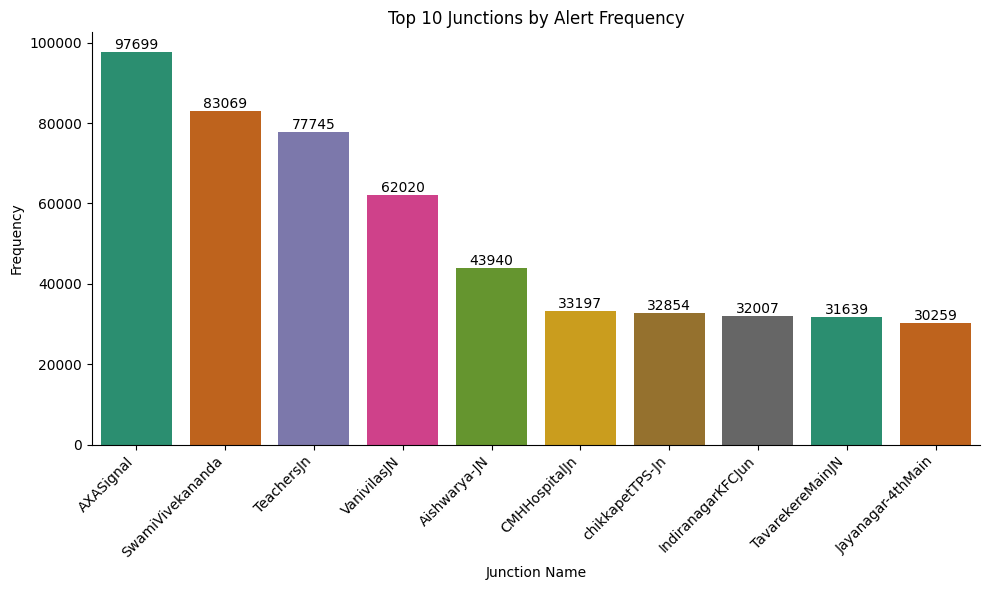

In [23]:
junction_counts = filtered_df['junctionName'].value_counts()

# Select the top 10 junctions
top_10_junctions = junction_counts.head(10)

# Plotting
plt.figure(figsize=(10, 6))
ax = sns.barplot(x=top_10_junctions.index, y=top_10_junctions.values, palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}',
                (p.get_x() + p.get_width() / 2, p.get_height()),
                ha='center', va='bottom', fontsize=10, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Junction Name')
plt.ylabel('Frequency')
plt.title('Top 10 Junctions by Alert Frequency')
plt.xticks(rotation=45, ha='right')  # Rotate x-labels for better readability
plt.tight_layout()
plt.show()

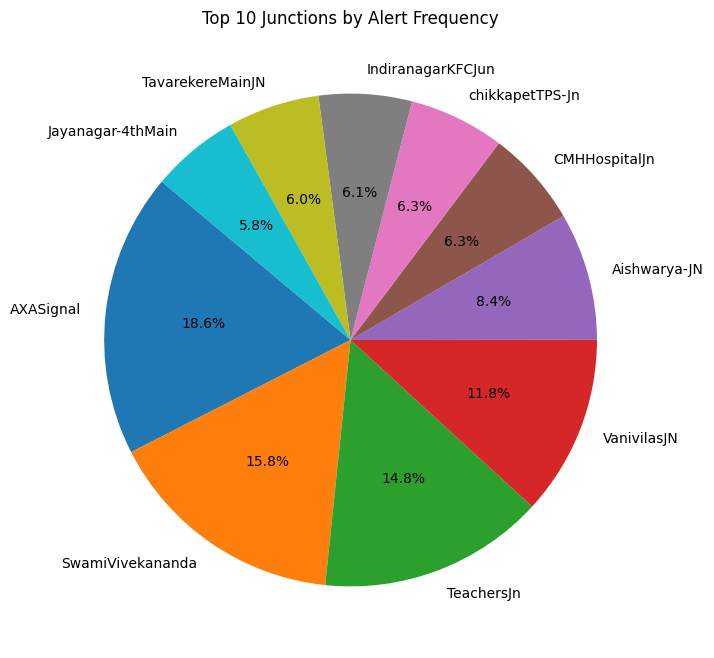

In [24]:
plt.figure(figsize=(8, 8))
plt.pie(top_10_junctions, labels=top_10_junctions.index, autopct='%1.1f%%', startangle=140)
plt.title('Top 10 Junctions by Alert Frequency')
plt.show()

Focusing on SwamiVivekananda

C:\Users\CiSTUP\AppData\Local\Temp\ipykernel_11348\2913629383.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y='alertType', data=swami_vivekananda_df, palette='Dark2')


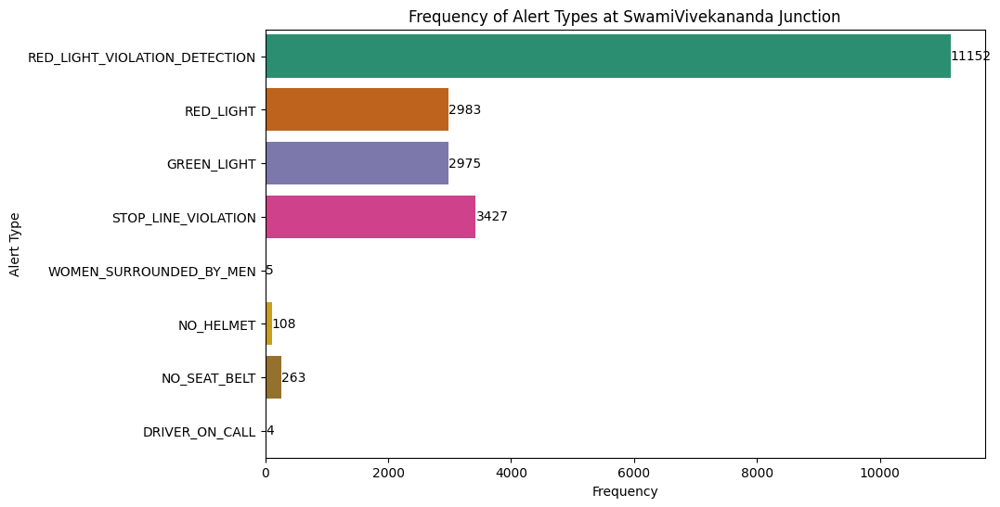

In [48]:
# Filter the DataFrame to include only events at the 'SwamiVivekananda' junction
swami_vivekananda_df = filtered_df[filtered_df['junctionName'] == 'SwamiVivekananda']

plt.figure(figsize=(10, 6))
ax = sns.countplot(y='alertType', data=swami_vivekananda_df, palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_width())}',  # Add frequency value
                (p.get_width(), p.get_y() + p.get_height() / 2),  # Positioning
                ha='left', va='center', fontsize=10, color='black')  # Text style

plt.xlabel('Frequency')
plt.ylabel('Alert Type')
plt.title('Frequency of Alert Types at SwamiVivekananda Junction')
plt.show()


C:\Users\CiSTUP\AppData\Local\Temp\ipykernel_11348\1248671230.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(y='vehicleType', data=swami_vivekananda_df, palette='Dark2')


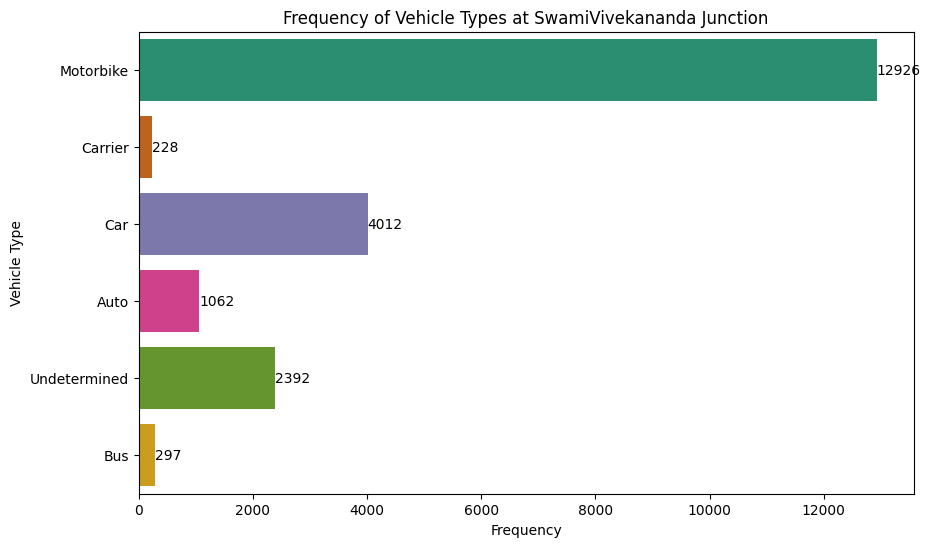

In [49]:
plt.figure(figsize=(10, 6))
ax = sns.countplot(y='vehicleType', data=swami_vivekananda_df, palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_width())}',
                (p.get_width(), p.get_y() + p.get_height() / 2),
                ha='left', va='center', fontsize=10, color='black')

plt.xlabel('Frequency')
plt.ylabel('Vehicle Type')
plt.title('Frequency of Vehicle Types at SwamiVivekananda Junction')
plt.show()

In [50]:
swami_vivekananda_df.head(5)

,id,junctionName,cameraUsage,observationDateTime,vehicleType,alertType,location.coordinates,location.type
0,5b778007-797e-4313-b34c-c7c4812365bb,SwamiVivekananda,ANPR,2024-02-21T09:50:35+05:30,Motorbike,RED_LIGHT_VIOLATION_DETECTION,"[77.631421, 12.981592]",Point
28,5b778007-797e-4313-b34c-c7c4812365bb,SwamiVivekananda,ANPR,2024-02-21T13:30:54+05:30,Motorbike,RED_LIGHT_VIOLATION_DETECTION,"[77.631421, 12.981592]",Point
29,5b778007-797e-4313-b34c-c7c4812365bb,SwamiVivekananda,ANPR,2024-02-21T13:30:53+05:30,Motorbike,RED_LIGHT_VIOLATION_DETECTION,"[77.631421, 12.981592]",Point
30,5b778007-797e-4313-b34c-c7c4812365bb,SwamiVivekananda,ANPR,2024-02-21T13:30:53+05:30,Motorbike,RED_LIGHT,"[77.631421, 12.981592]",Point
31,5b778007-797e-4313-b34c-c7c4812365bb,SwamiVivekananda,ANPR,2024-02-21T13:30:53+05:30,Motorbike,RED_LIGHT,"[77.631421, 12.981592]",Point


<Axes: xlabel='vehicleType'>

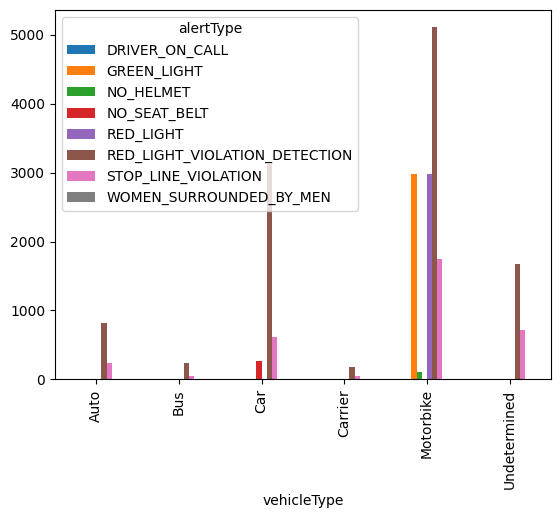

In [51]:
# @title Violations by Vehicle Type

swami_vivekananda_df.groupby(['vehicleType', 'alertType']).size().unstack().plot(kind='bar')

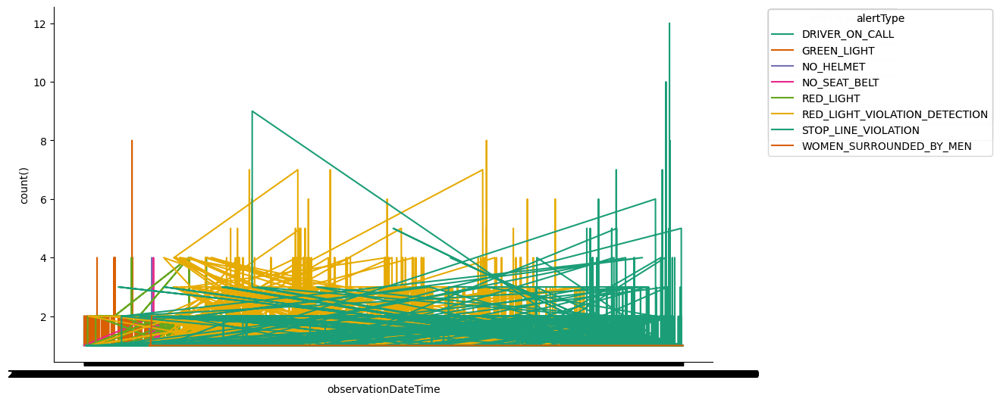

In [52]:
# @title observationDateTime vs count()

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['observationDateTime']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'observationDateTime'}, axis=1)
              .sort_values('observationDateTime', ascending=True))
  xs = counted['observationDateTime']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = swami_vivekananda_df.sort_values('observationDateTime', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('alertType')):
  _plot_series(series, series_name, i)
  fig.legend(title='alertType', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('observationDateTime')
_ = plt.ylabel('count()')

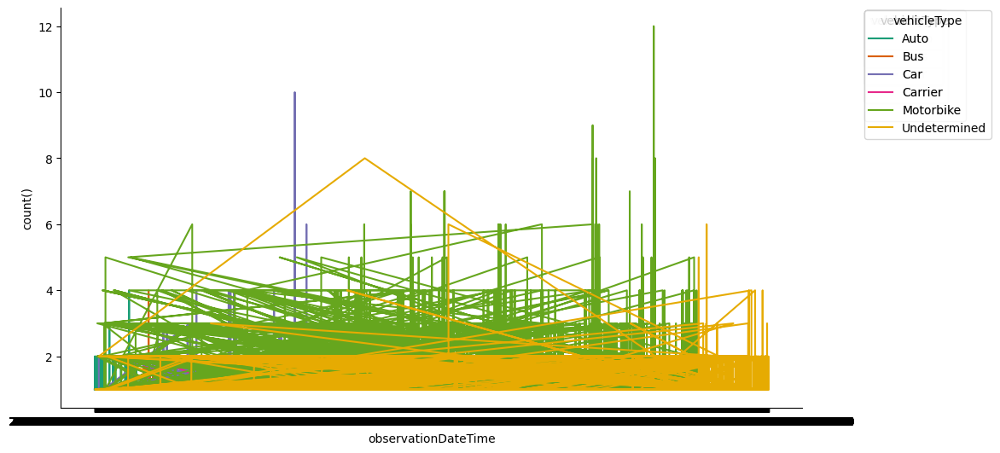

In [53]:
# @title observationDateTime vs count()

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['observationDateTime']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'observationDateTime'}, axis=1)
              .sort_values('observationDateTime', ascending=True))
  xs = counted['observationDateTime']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = swami_vivekananda_df.sort_values('observationDateTime', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('vehicleType')):
  _plot_series(series, series_name, i)
  fig.legend(title='vehicleType', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('observationDateTime')
_ = plt.ylabel('count()')

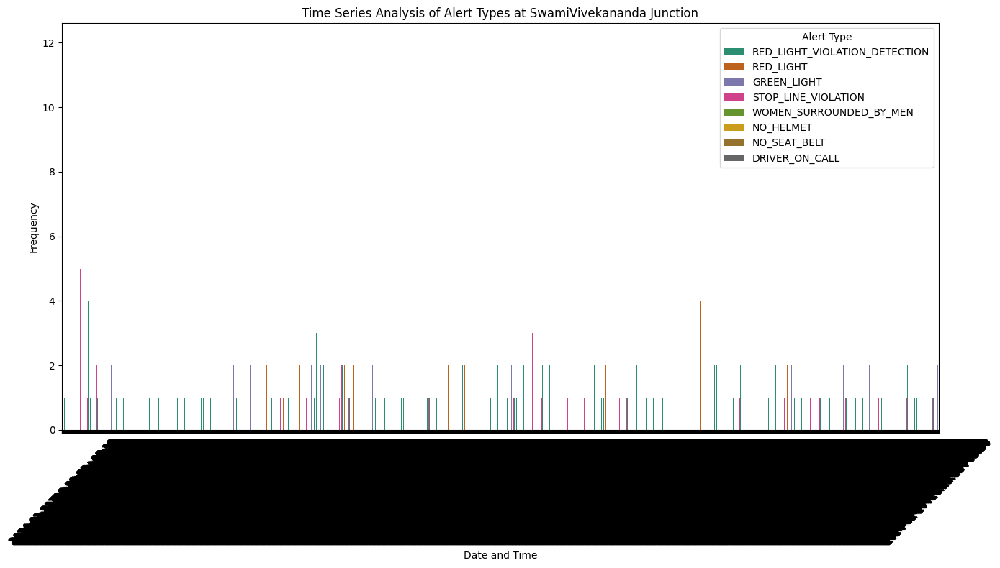

In [54]:
# Plotting the time series analysis for alert types
plt.figure(figsize=(14, 8))
sns.countplot(x='observationDateTime', data=swami_vivekananda_df, hue='alertType', palette='Dark2')
plt.xlabel('Date and Time')
plt.ylabel('Frequency')
plt.title('Time Series Analysis of Alert Types at SwamiVivekananda Junction')
plt.xticks(rotation=45)
plt.legend(title='Alert Type', loc='upper right')
plt.tight_layout()
plt.show()

# Plotting the time series analysis for vehicle types
plt.figure(figsize=(14, 8))
sns.countplot(x='observationDateTime', data=swami_vivekananda_df, hue='vehicleType', palette='Dark2')
plt.xlabel('Date and Time')
plt.ylabel('Frequency')
plt.title('Time Series Analysis of Vehicle Types at SwamiVivekananda Junction')
plt.xticks(rotation=45)
plt.legend(title='Vehicle Type', loc='upper right')
plt.tight_layout()
plt.show()

In [10]:
df1 = pd.DataFrame(filtered_df)
df1['observationDateTime'] = pd.to_datetime(df1['observationDateTime'])
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()
print(df1)

                                           id   vehicleType  \
0        5b778007-797e-4313-b34c-c7c4812365bb           Car   
2        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
3        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
4        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
5        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
...                                       ...           ...   
4753001  5b778007-797e-4313-b34c-c7c4812365bb           Car   
4753002  5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
4753003  5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
4753004  5b778007-797e-4313-b34c-c7c4812365bb  Undetermined   
4753005  5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   

                             alertType       observationDateTime cameraUsage  \
0                  STOP_LINE_VIOLATION 2024-02-21 13:29:49+05:30        ANPR   
2                  STOP_LINE_VIOLATION 2024-02-21 13:30:00+05:30        ANPR   
3  

In [11]:
df1.head()

,id,vehicleType,alertType,observationDateTime,cameraUsage,junctionName,location.type,location.coordinates,dayOfWeek
0,5b778007-797e-4313-b34c-c7c4812365bb,Car,STOP_LINE_VIOLATION,2024-02-21 13:29:49+05:30,ANPR,SampigeRoad,Point,"[77.571138, 13.008491]",Wednesday
2,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,STOP_LINE_VIOLATION,2024-02-21 13:30:00+05:30,ANPR,Mariyappacircle,Point,"[77.63721, 13.022783]",Wednesday
3,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,RED_LIGHT_VIOLATION_DETECTION,2024-02-21 13:29:59+05:30,ANPR,Mariyappacircle,Point,"[77.63721, 13.022783]",Wednesday
4,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,RED_LIGHT_VIOLATION_DETECTION,2024-02-21 13:10:36+05:30,ANPR,Chindrikahotel,Point,"[77.593048, 12.989344]",Wednesday
5,5b778007-797e-4313-b34c-c7c4812365bb,Motorbike,RED_LIGHT_VIOLATION_DETECTION,2024-02-21 13:10:36+05:30,ANPR,PromenadeWheelresroadJn,Point,"[77.61448, 12.991661]",Wednesday


In [12]:
print(df1.info)

<bound method DataFrame.info of                                            id   vehicleType  \
0        5b778007-797e-4313-b34c-c7c4812365bb           Car   
2        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
3        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
4        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
5        5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
...                                       ...           ...   
4753001  5b778007-797e-4313-b34c-c7c4812365bb           Car   
4753002  5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
4753003  5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   
4753004  5b778007-797e-4313-b34c-c7c4812365bb  Undetermined   
4753005  5b778007-797e-4313-b34c-c7c4812365bb     Motorbike   

                             alertType       observationDateTime cameraUsage  \
0                  STOP_LINE_VIOLATION 2024-02-21 13:29:49+05:30        ANPR   
2                  STOP_LINE_VIOLATION 2024-02-21 1

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\3159896193.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.countplot(x='dayOfWeek', data=df1, order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], palette='Dark2')


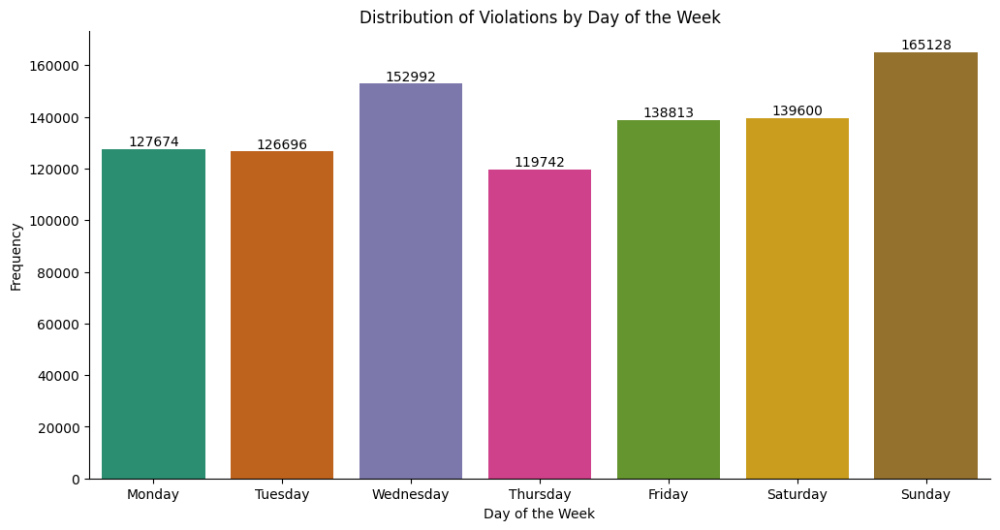

In [13]:
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()

# Plotting the distribution of violations by the day of the week
plt.figure(figsize=(12, 6))
ax = sns.countplot(x='dayOfWeek', data=df1, order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    ax.annotate(f'{int(p.get_height())}',
                (p.get_x() + p.get_width() / 2, p.get_height()),
                ha='center', va='bottom', fontsize=10, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Day of the Week')
plt.ylabel('Frequency')
plt.title('Distribution of Violations by Day of the Week')
plt.show()

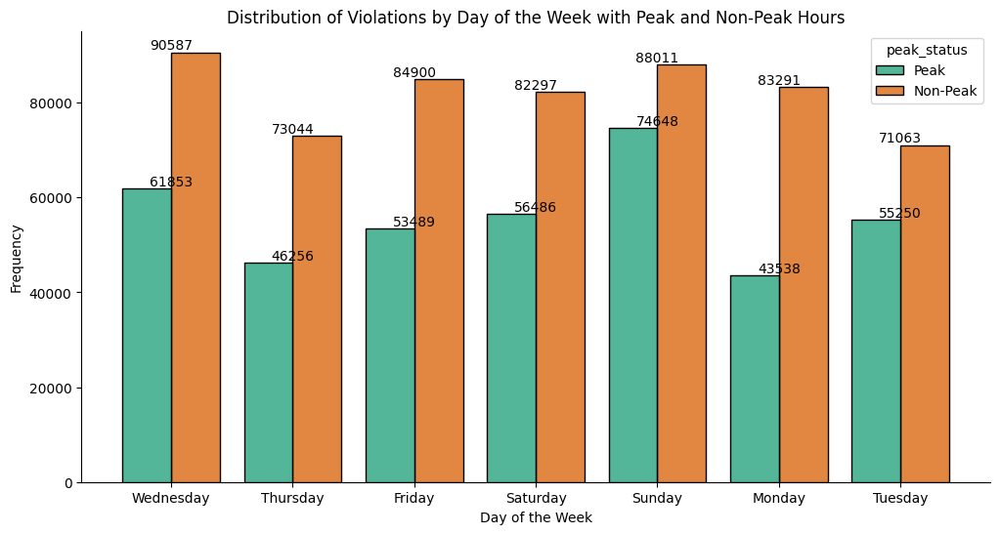

In [39]:
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()
df1['hour'] = df1['observationDateTime'].dt.hour
def classify_peak_hour(hour):
    if (7 <= hour < 11) or (16 <= hour < 20):
        return 'Peak'
    else:
        return 'Non-Peak'

df1['peak_status'] = df1['hour'].apply(classify_peak_hour)

# Plotting the distribution of violations by the day of the week with peak and non-peak hours
plt.figure(figsize=(12, 6))

# Use sns.histplot to plot both peak and non-peak data with a 'dodge' parameter
sns.histplot(data=df1, x='dayOfWeek', hue='peak_status', multiple='dodge', 
             hue_order=['Peak', 'Non-Peak'], palette='Dark2', discrete=True, shrink=0.8)

# Adding counts on top of the bars
day_of_week_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
for day in day_of_week_order:
    peak_count = df1[(df1['dayOfWeek'] == day) & (df1['peak_status'] == 'Peak')].shape[0]
    non_peak_count = df1[(df1['dayOfWeek'] == day) & (df1['peak_status'] == 'Non-Peak')].shape[0]

    plt.text(day, peak_count + 0.5, str(peak_count), color='black', ha="center", va="bottom", fontsize=10)
    plt.text(day, non_peak_count + 0.5, str(non_peak_count), color='black', ha="center", va="bottom", fontsize=10)

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Day of the Week')
plt.ylabel('Frequency')
plt.title('Distribution of Violations by Day of the Week with Peak and Non-Peak Hours')
plt.show()

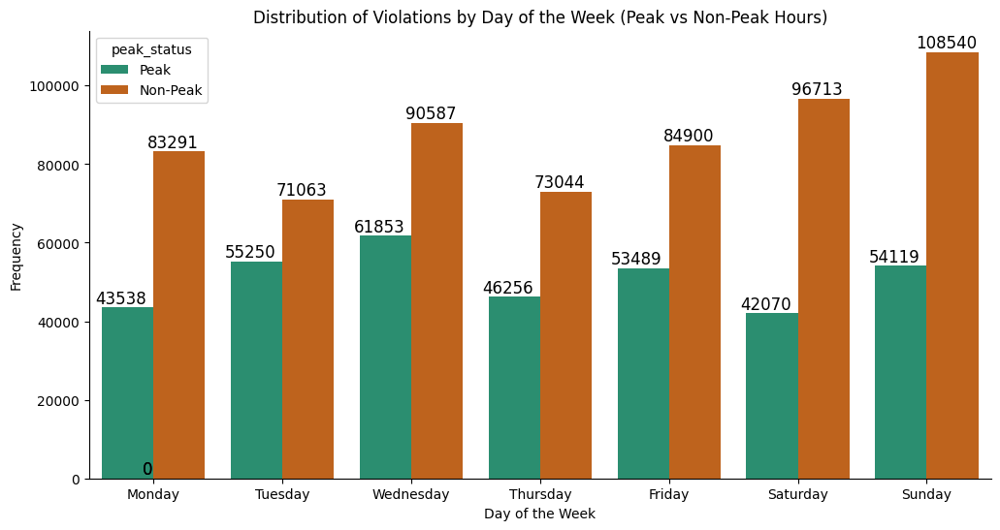

In [45]:
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()
df1['hour'] = df1['observationDateTime'].dt.hour

def classify_peak_hour(row):
    day = row['dayOfWeek']
    hour = row['hour']
    
    if day in ['Saturday', 'Sunday']:
        # Weekend peak hours
        if (11 <= hour < 14) or (18 <= hour < 23):
            return 'Peak'
        else:
            return 'Non-Peak'
    else:
        # Weekday peak hours
        if (7 <= hour < 11) or (16 <= hour < 20):
            return 'Peak'
        else:
            return 'Non-Peak'

df1['peak_status'] = df1.apply(classify_peak_hour, axis=1)

# Plotting the distribution of violations by the day of the week with peak and non-peak hours
plt.figure(figsize=(12, 6))

# Use sns.countplot to plot both peak and non-peak data with a 'dodge' parameter
ax = sns.countplot(data=df1, x='dayOfWeek', hue='peak_status', palette='Dark2', dodge=True,
                   hue_order=['Peak', 'Non-Peak'], order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Adding counts on top of the bars
for p in ax.patches:
    count = int(p.get_height())
    x = p.get_x() + p.get_width() / 2 - 0.05
    y = p.get_height()
    ax.annotate(count, (x, y), ha='center', va='bottom', fontsize=12, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Day of the Week')
plt.ylabel('Frequency')
plt.title('Distribution of Violations by Day of the Week (Peak vs Non-Peak Hours)')
plt.show()

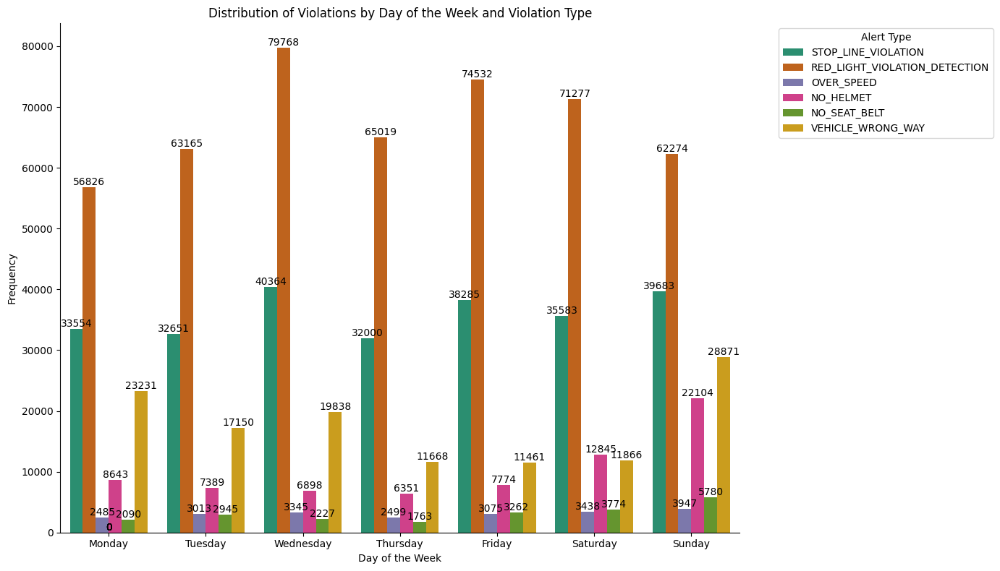

In [48]:
# Plotting the distribution of violations by the day of the week with alert types
plt.figure(figsize=(14, 8))
ax = sns.countplot(x='dayOfWeek', hue='alertType', data=df1, order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], palette='Dark2')

# Adding counts on top of the bars
for p in ax.patches:
    width = p.get_width()
    height = p.get_height()
    x, y = p.get_xy() 
    ax.annotate(f'{int(height)}', (x + width/2, y + height), ha='center', va='bottom', fontsize=10, color='black')

plt.gca().spines['top'].set_visible(False)  # Hide top spine
plt.gca().spines['right'].set_visible(False)  # Hide right spine
plt.xlabel('Day of the Week')
plt.ylabel('Frequency')
plt.title('Distribution of Violations by Day of the Week and Violation Type')
plt.legend(title='Alert Type', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

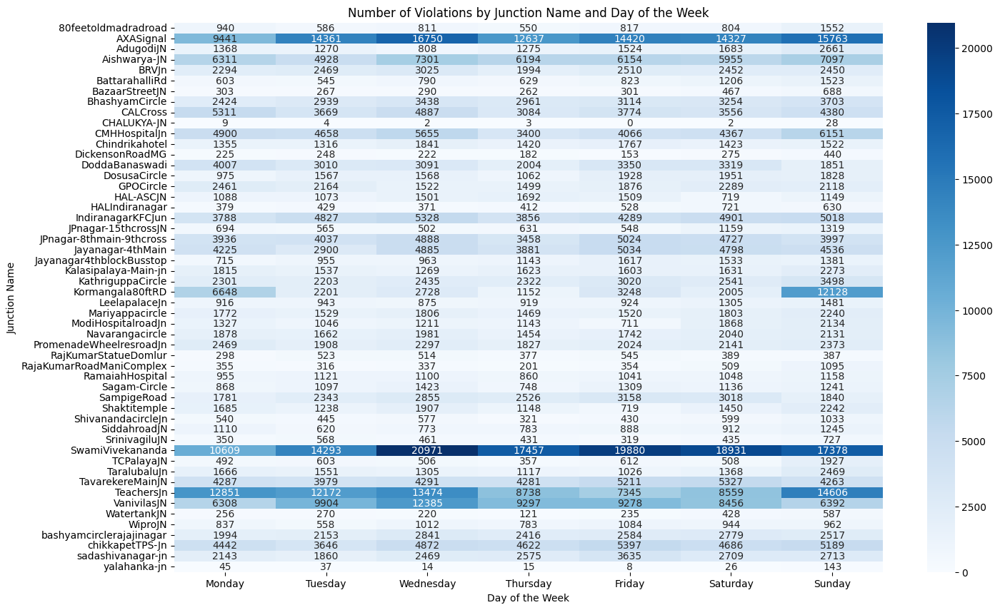

In [27]:
df1['observationDateTime'] = pd.to_datetime(df1['observationDateTime'])

# Add a new column 'dayOfWeek' representing the day of the week
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()

# Reordering the days of the week starting from Monday
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df1['dayOfWeek'] = pd.Categorical(df1['dayOfWeek'], categories=ordered_days, ordered=True)

# Grouping the data by junction name and day of the week and counting the occurrences
junction_day_counts = df1.groupby(['junctionName', 'dayOfWeek']).size().unstack(fill_value=0)

# Plotting the heatmap
plt.figure(figsize=(16, 10))
sns.heatmap(junction_day_counts, cmap='Blues', annot=True, fmt='d')
plt.xlabel('Day of the Week')
plt.ylabel('Junction Name')
plt.title('Number of Violations by Junction Name and Day of the Week')
plt.show()

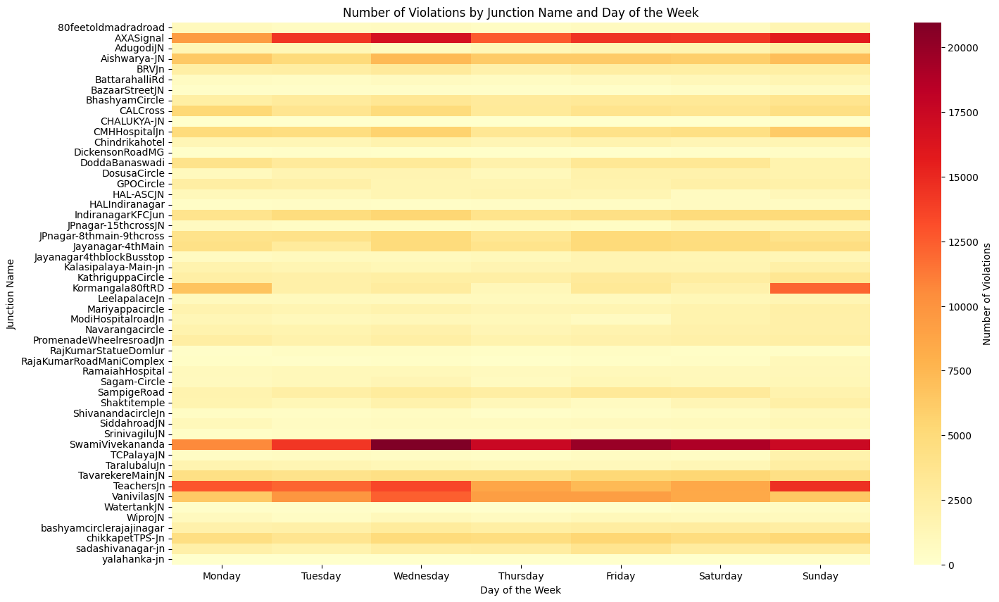

In [38]:
df1['observationDateTime'] = pd.to_datetime(df1['observationDateTime'])

# Add a new column 'dayOfWeek' representing the day of the week
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()

# Grouping the data by junction name and day of the week and counting the occurrences
junction_day_counts = df1.groupby(['junctionName', 'dayOfWeek']).size().unstack(fill_value=0)

# Reorder the days of the week
junction_day_counts = junction_day_counts[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']]

# Plotting the heatmap without annotations
plt.figure(figsize=(16, 10))
sns.heatmap(junction_day_counts, cmap='YlOrRd', cbar_kws={'label': 'Number of Violations'})
plt.xlabel('Day of the Week')
plt.ylabel('Junction Name')
plt.title('Number of Violations by Junction Name and Day of the Week')
plt.show()

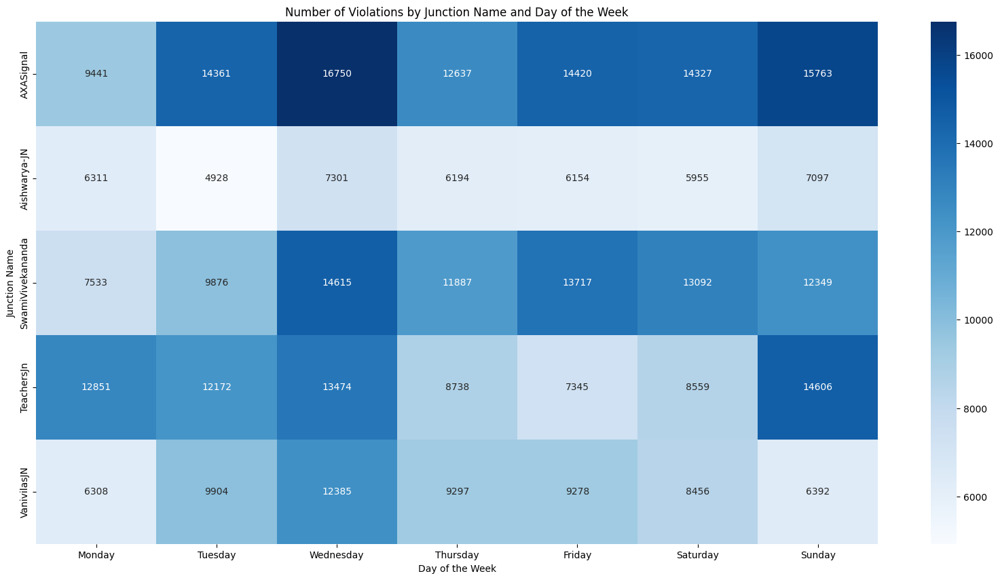

In [38]:
df1['observationDateTime'] = pd.to_datetime(df1['observationDateTime'])

# Add a new column 'dayOfWeek' representing the day of the week
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()

# Reordering the days of the week starting from Monday
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df1['dayOfWeek'] = pd.Categorical(df1['dayOfWeek'], categories=ordered_days, ordered=True)

# Filter data for the specified junctions
locations = ['SwamiVivekananda', 'AXASignal', 'TeachersJn', 'VanivilasJN', 'Aishwarya-JN']
filtered_df1 = df1[df1['junctionName'].isin(locations)]

# Grouping the data by junction name and day of the week and counting the occurrences
junction_day_counts = filtered_df1.groupby(['junctionName', 'dayOfWeek']).size().unstack(fill_value=0)

# Plotting the heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(junction_day_counts, cmap='Blues', annot=True, fmt='d')
plt.xlabel('Day of the Week')
plt.ylabel('Junction Name')
plt.title('Number of Violations by Junction Name and Day of the Week')
plt.show()

c:\Users\HP\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:854: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  func(*plot_args, **plot_kwargs)
c:\Users\HP\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:854: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  func(*plot_args, **plot_kwargs)
c:\Users\HP\AppData\Local\Programs\Python\Python310\lib\site-packages\seaborn\axisgrid.py:854: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  func(*plot_args, **plot_kwargs)
c:\Users\HP\AppData\Local\Programs\Python\Python310\lib\site-pac

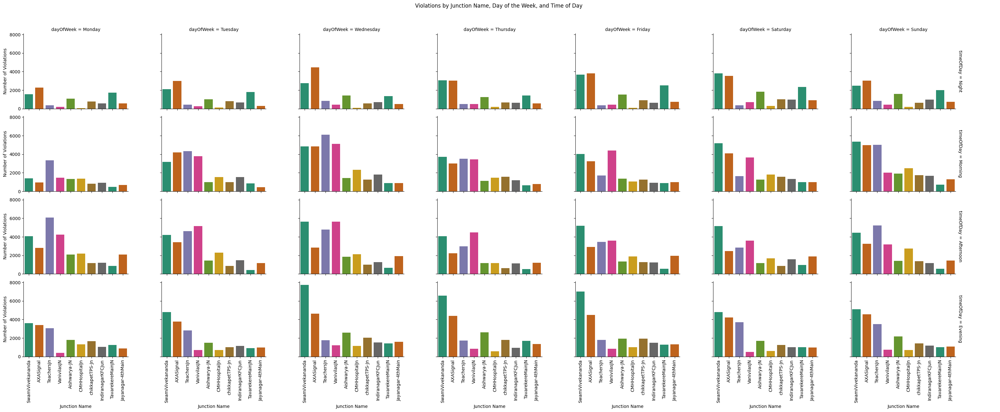

In [33]:
df1['observationDateTime'] = pd.to_datetime(df1['observationDateTime'])

# Add a new column 'dayOfWeek' representing the day of the week
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()

# Add a new column 'hourOfDay' representing the hour of the day
df1['hourOfDay'] = df1['observationDateTime'].dt.hour

# Define time bins for different time periods of the day
time_bins = [0, 6, 12, 18, 24]
time_labels = ['Night', 'Morning', 'Afternoon', 'Evening']
df1['timeOfDay'] = pd.cut(df1['hourOfDay'], bins=time_bins, labels=time_labels, right=False)

# Reordering the days of the week starting from Monday
ordered_days = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df1['dayOfWeek'] = pd.Categorical(df1['dayOfWeek'], categories=ordered_days, ordered=True)

# Filter data for the top 10 junctions based on the number of violations
top_10_junctions = df1['junctionName'].value_counts().head(10).index
filtered_df1 = df1[df1['junctionName'].isin(top_10_junctions)]

# Create a facet grid to visualize the data
g = sns.FacetGrid(filtered_df1, col='dayOfWeek', row='timeOfDay', margin_titles=True, height=3, aspect=1.5)
g.map(sns.countplot, 'junctionName', order=top_10_junctions, palette='Dark2')
g.add_legend()

# Adjusting labels for better readability
for ax in g.axes.flatten():
    for label in ax.get_xticklabels():
        label.set_rotation(90)
    ax.set_xlabel('')
    ax.set_ylabel('')

g.set_axis_labels('Junction Name', 'Number of Violations')
plt.subplots_adjust(top=0.9)
g.fig.suptitle('Violations by Junction Name, Day of the Week, and Time of Day')
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\1680755949.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekday_df['hour'] = weekday_df['observationDateTime'].dt.hour


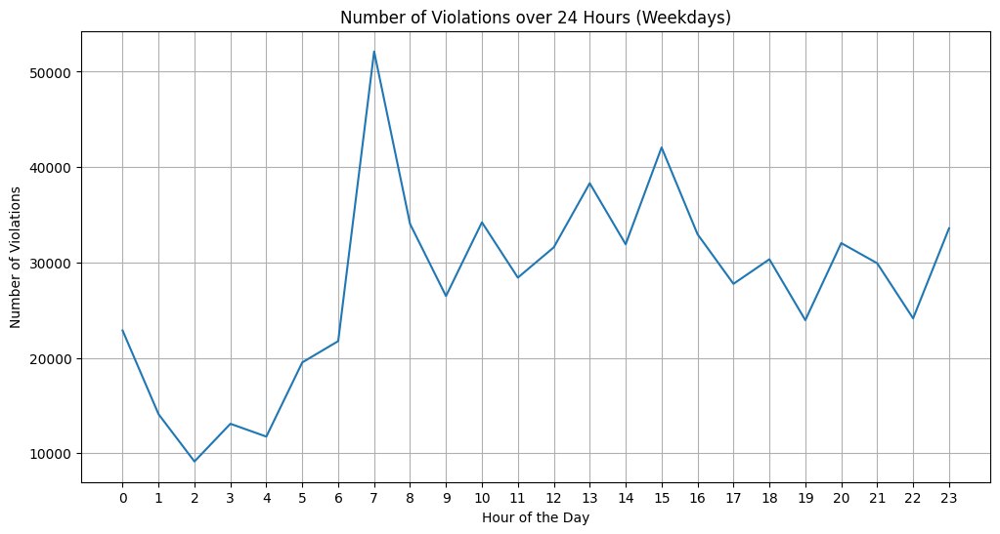

In [14]:
weekdays = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']
weekday_df = df1[df1['dayOfWeek'].isin(weekdays)]

# Extract the hour from 'observationDateTime'
weekday_df['hour'] = weekday_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = weekday_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for weekdays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values)
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours (Weekdays)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\3001697928.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekday_df['hour'] = weekday_df['observationDateTime'].dt.hour


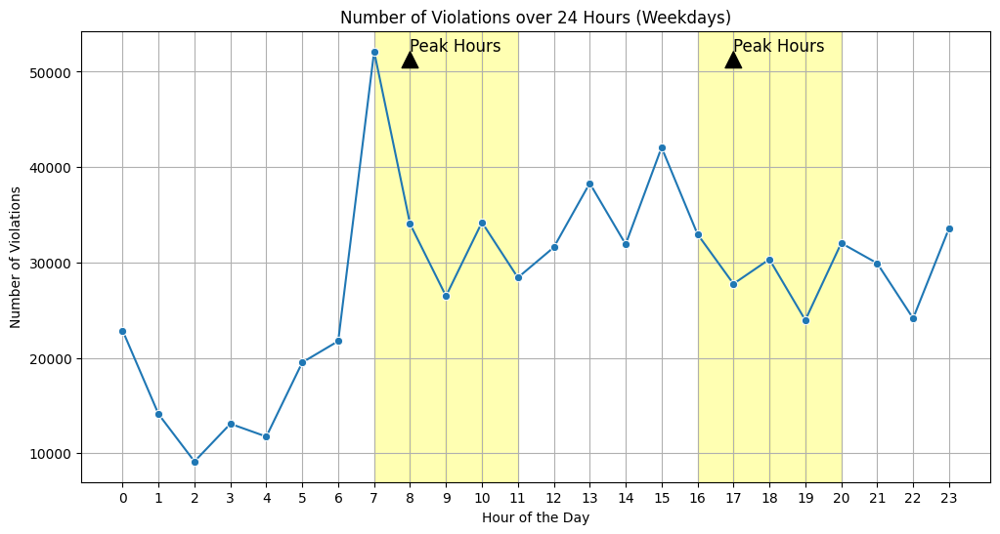

In [15]:

weekdays = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']
weekday_df = df1[df1['dayOfWeek'].isin(weekdays)]

# Extract the hour from 'observationDateTime'
weekday_df['hour'] = weekday_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = weekday_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for weekdays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values, marker='o')

# Highlighting peak hours
peak_hours_1 = range(7, 11)  # 7:30 am to 11 am
peak_hours_2 = range(16, 20) # 4:30 pm to 8:30 pm

# Shading the peak hours
for hour in peak_hours_1:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

for hour in peak_hours_2:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

# Add annotations for peak hours
plt.annotate('Peak Hours', xy=(8, max(hourly_violations) - 1), xytext=(8, max(hourly_violations) + 5),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)
plt.annotate('Peak Hours', xy=(17, max(hourly_violations) - 1), xytext=(17, max(hourly_violations) + 5),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours (Weekdays)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\439760468.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekend_df['hour'] = weekend_df['observationDateTime'].dt.hour


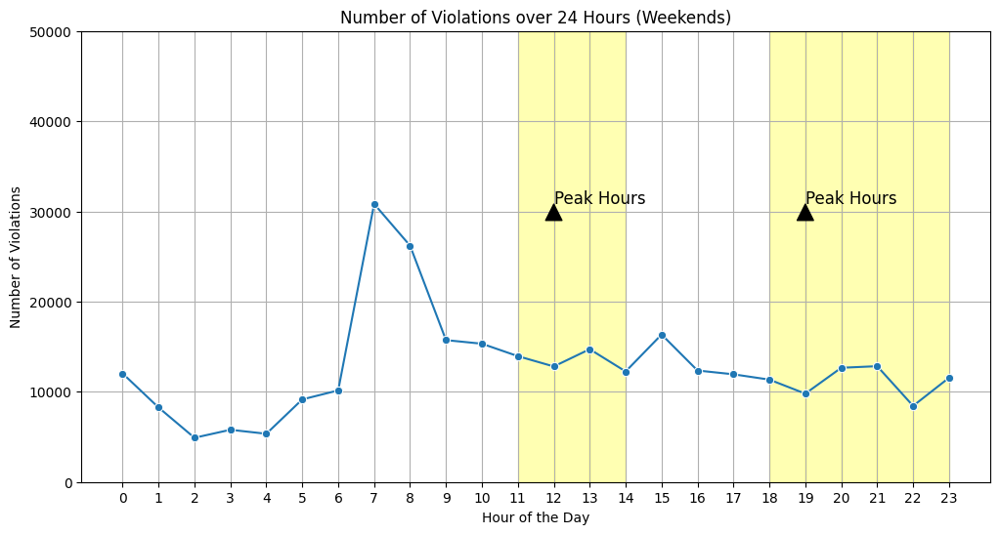

In [17]:
weekends = ['Saturday', 'Sunday']
weekend_df = df1[df1['dayOfWeek'].isin(weekends)]

# Extract the hour from 'observationDateTime'
weekend_df['hour'] = weekend_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = weekend_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for weekends
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values, marker='o')

# Highlighting peak hours
peak_hours_1 = range(11, 14)  # 11 am to 2 pm
peak_hours_2 = range(18, 23)  # 6:30 pm to 11 pm

# Shading the peak hours
for hour in peak_hours_1:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

for hour in peak_hours_2:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

# Add annotations for peak hours
plt.annotate('Peak Hours', xy=(12, max(hourly_violations) - 1), xytext=(12, max(hourly_violations) + 5),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)
plt.annotate('Peak Hours', xy=(19, max(hourly_violations) - 1), xytext=(19, max(hourly_violations) + 5),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)

# Set y-axis limit to 50,000
plt.ylim(0, 50000)

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours (Weekends)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

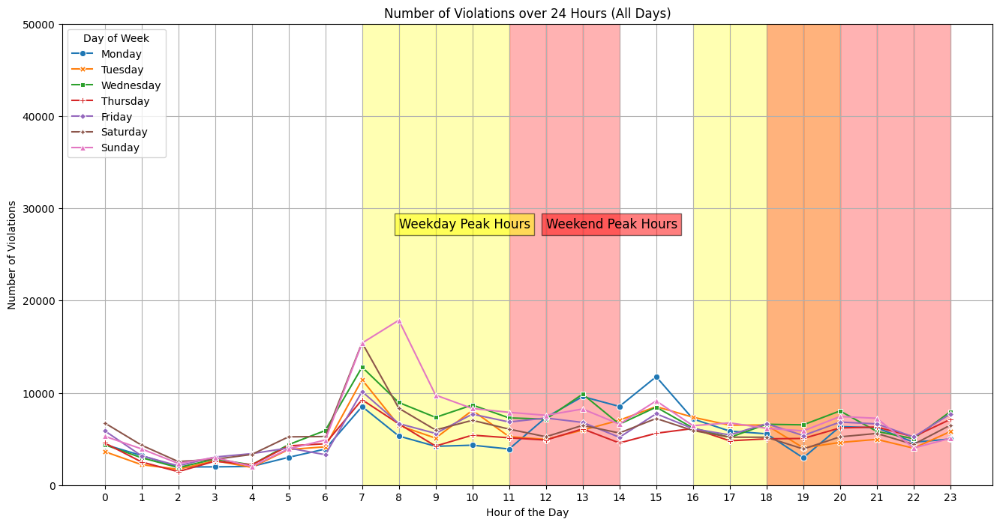

In [18]:
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()
df1['hour'] = df1['observationDateTime'].dt.hour

# Classify peak and non-peak hours
def classify_peak_hour(row):
    day = row['dayOfWeek']
    hour = row['hour']
    
    if day in ['Saturday', 'Sunday']:
        # Weekend peak hours
        if (11 <= hour < 14) or (18 <= hour < 23):
            return 'Peak'
        else:
            return 'Non-Peak'
    else:
        # Weekday peak hours
        if (7 <= hour < 11) or (16 <= hour < 20):
            return 'Peak'
        else:
            return 'Non-Peak'

df1['peak_status'] = df1.apply(classify_peak_hour, axis=1)

# Group by hour and count the number of violations for each hour
hourly_violations = df1.groupby(['hour', 'dayOfWeek']).size().unstack(fill_value=0)

# Ensure the days of the week are ordered correctly
hourly_violations = hourly_violations[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']]

# Plotting the time series of violations over 24 hours for all days
plt.figure(figsize=(16, 8))
sns.lineplot(data=hourly_violations, markers=True, dashes=False)

# Highlighting peak hours for weekdays
weekday_peak_hours_1 = range(7, 11)  # 7:00 am to 11:00 am
weekday_peak_hours_2 = range(16, 20)  # 4:00 pm to 8:00 pm

for hour in weekday_peak_hours_1:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

for hour in weekday_peak_hours_2:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

# Highlighting peak hours for weekends
weekend_peak_hours_1 = range(11, 14)  # 11:00 am to 2:00 pm
weekend_peak_hours_2 = range(18, 23)  # 6:00 pm to 11:00 pm

for hour in weekend_peak_hours_1:
    plt.axvspan(hour, hour + 1, color='red', alpha=0.3)

for hour in weekend_peak_hours_2:
    plt.axvspan(hour, hour + 1, color='red', alpha=0.3)

# Add annotations for peak hours
plt.annotate('Weekday Peak Hours', xy=(8, max(hourly_violations.max()) + 5000), 
             xytext=(8, max(hourly_violations.max()) + 10000), fontsize=12, 
             bbox=dict(facecolor='yellow', alpha=0.5))
plt.annotate('Weekend Peak Hours', xy=(12, max(hourly_violations.max()) + 5000), 
             xytext=(12, max(hourly_violations.max()) + 10000), fontsize=12, 
             bbox=dict(facecolor='red', alpha=0.5))

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours (All Days)')
plt.xticks(range(0, 24))
plt.ylim(0, 50000)
plt.grid(True)
plt.legend(title='Day of Week')
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\3417082802.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekday_df['hour'] = weekday_df['observationDateTime'].dt.hour
C:\Users\HP\AppData\Local\Temp\ipykernel_15004\3417082802.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekend_df['hour'] = weekend_df['observationDateTime'].dt.hour


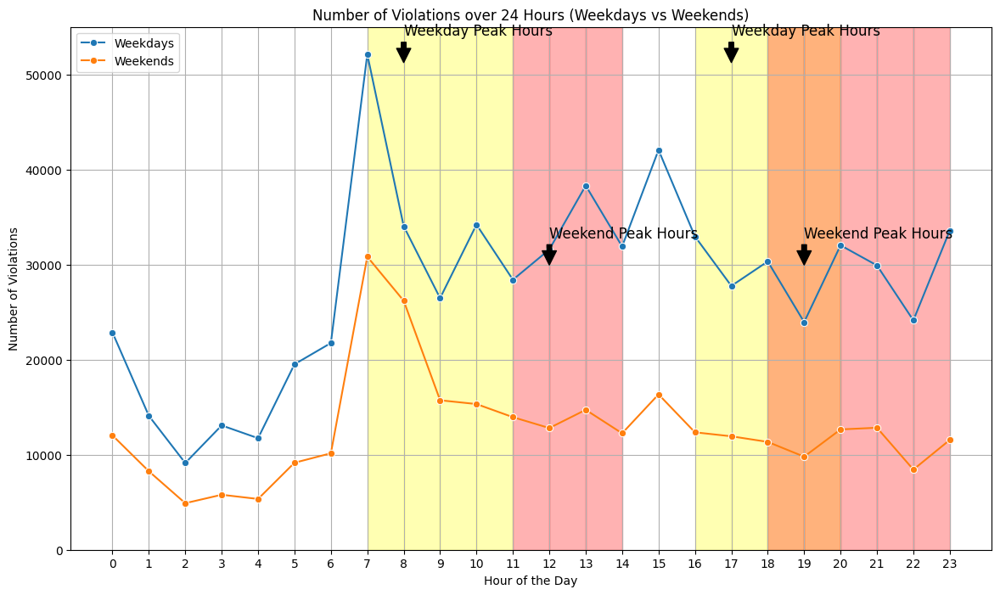

In [25]:
df1['dayOfWeek'] = df1['observationDateTime'].dt.day_name()
df1['hour'] = df1['observationDateTime'].dt.hour

# Weekday Data
weekdays = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']
weekday_df = df1[df1['dayOfWeek'].isin(weekdays)]
weekday_df['hour'] = weekday_df['observationDateTime'].dt.hour
weekday_hourly_violations = weekday_df.groupby('hour').size()

# Weekend Data
weekends = ['Saturday', 'Sunday']
weekend_df = df1[df1['dayOfWeek'].isin(weekends)]
weekend_df['hour'] = weekend_df['observationDateTime'].dt.hour
weekend_hourly_violations = weekend_df.groupby('hour').size()

# Plotting
plt.figure(figsize=(14, 8))

# Weekday Violations
sns.lineplot(x=weekday_hourly_violations.index, y=weekday_hourly_violations.values, marker='o', label='Weekdays')

# Weekend Violations
sns.lineplot(x=weekend_hourly_violations.index, y=weekend_hourly_violations.values, marker='o', label='Weekends')

# Highlighting Weekday Peak Hours
weekday_peak_hours_1 = range(7, 11)  # 7:30 am to 11 am
weekday_peak_hours_2 = range(16, 20) # 4:30 pm to 8:30 pm

for hour in weekday_peak_hours_1:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

for hour in weekday_peak_hours_2:
    plt.axvspan(hour, hour + 1, color='yellow', alpha=0.3)

# Highlighting Weekend Peak Hours
weekend_peak_hours_1 = range(11, 14)  # 11 am to 2 pm
weekend_peak_hours_2 = range(18, 23)  # 6:30 pm to 11 pm

for hour in weekend_peak_hours_1:
    plt.axvspan(hour, hour + 1, color='red', alpha=0.3)

for hour in weekend_peak_hours_2:
    plt.axvspan(hour, hour + 1, color='red', alpha=0.3)

# Adding annotations
plt.annotate('Weekday Peak Hours', xy=(8, max(weekday_hourly_violations) - 1000), xytext=(8, max(weekday_hourly_violations) + 2000),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)
plt.annotate('Weekday Peak Hours', xy=(17, max(weekday_hourly_violations) - 1000), xytext=(17, max(weekday_hourly_violations) + 2000),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)
plt.annotate('Weekend Peak Hours', xy=(12, max(weekend_hourly_violations) - 1000), xytext=(12, max(weekend_hourly_violations) + 2000),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)
plt.annotate('Weekend Peak Hours', xy=(19, max(weekend_hourly_violations) - 1000), xytext=(19, max(weekend_hourly_violations) + 2000),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=12)

# Set y-axis limit to 50,000
plt.ylim(0, 55000)

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours (Weekdays vs Weekends)')
plt.xticks(range(0, 24))
plt.legend()
plt.grid(True)
plt.show()

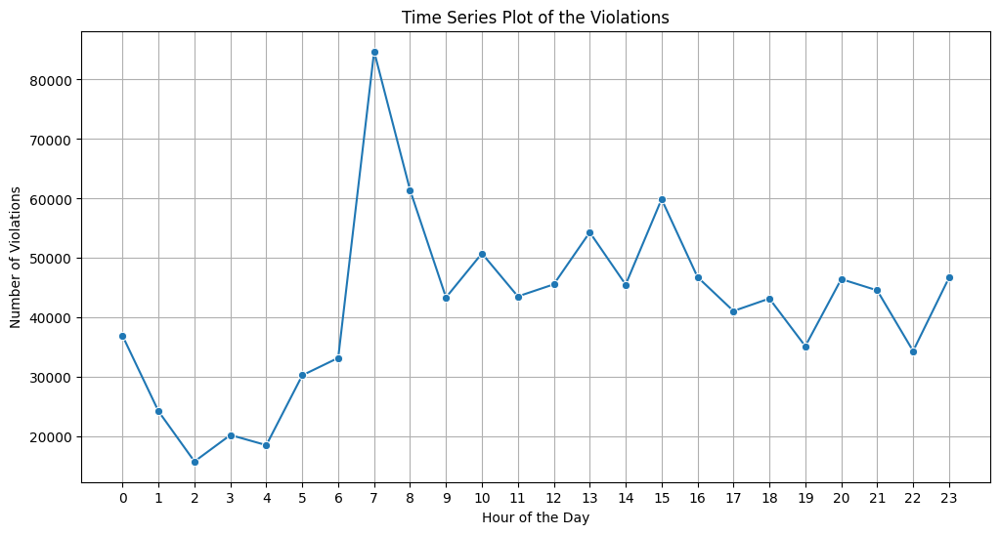

In [51]:
df1['hour'] = df1['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = df1.groupby('hour').size()

# Plotting the time series of violations over 24 hours for all days
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values, marker='o')

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Time Series Plot of the Violations')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

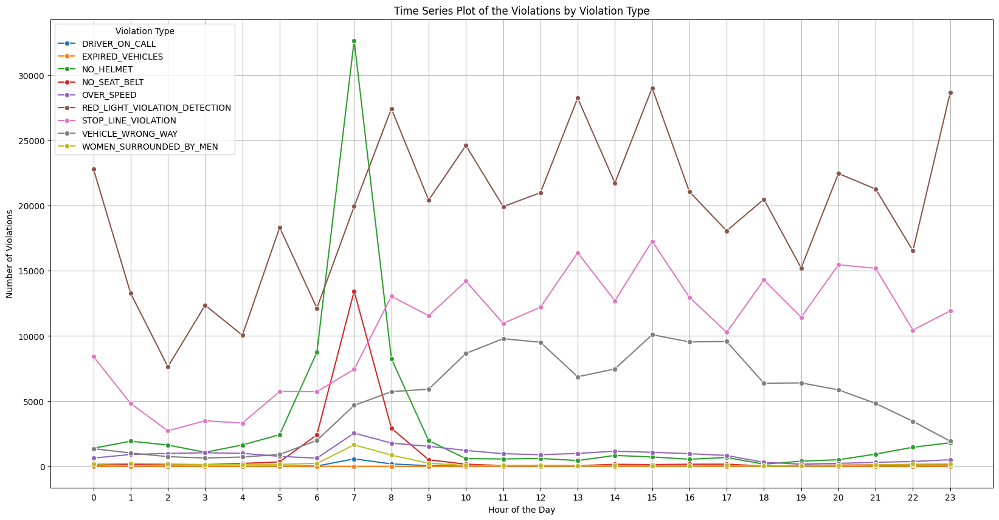

In [82]:
df1['hour'] = df1['observationDateTime'].dt.hour

# Group by hour and alert type, then count the number of violations for each group
hourly_violations = df1.groupby(['hour', 'alertType']).size().unstack(fill_value=0)

# Plotting the time series of violations over 24 hours for different alert types
plt.figure(figsize=(20, 10))

# Plot each alert type
for alert_type in hourly_violations.columns:
    sns.lineplot(x=hourly_violations.index, y=hourly_violations[alert_type], marker='o', label=alert_type)

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Time Series Plot of the Violations by Violation Type')
plt.xticks(range(0, 24))
plt.legend(title='Violation Type')
plt.grid(True)
plt.show()

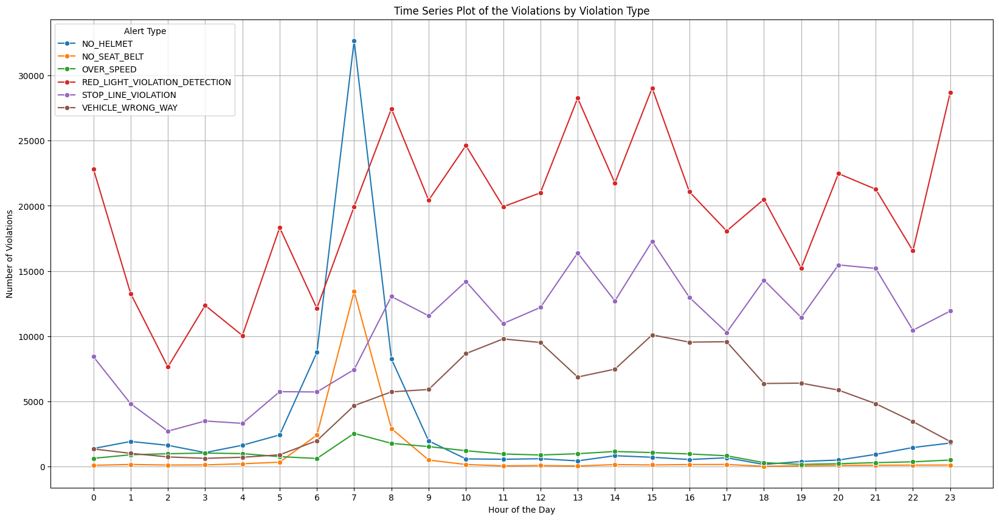

In [81]:
df1['hour'] = df1['observationDateTime'].dt.hour
alert_types_to_include = [
    'RED_LIGHT_VIOLATION_DETECTION', 'STOP_LINE_VIOLATION', 'VEHICLE_WRONG_WAY',
    'NO_HELMET', 'NO_SEAT_BELT', 'OVER_SPEED'
]
filtered_df = df1[df1['alertType'].isin(alert_types_to_include)]

# Group by hour and alert type, then count the number of violations for each group
hourly_violations = filtered_df.groupby(['hour', 'alertType']).size().unstack(fill_value=0)

# Plotting the time series of violations over 24 hours for different alert types
plt.figure(figsize=(20, 10))

# Plot each alert type
for alert_type in hourly_violations.columns:
    sns.lineplot(x=hourly_violations.index, y=hourly_violations[alert_type], marker='o', label=alert_type)

# Labeling and formatting the plot
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Time Series Plot of the Violations by Violation Type')
plt.xticks(range(0, 24))
plt.legend(title='Alert Type')
plt.grid(True)
plt.show()

In [79]:

import folium

# Define the coordinates and location names for the points
points = {
    "SwamiVivekananda": {"coordinates": [12.981592, 77.631421], "name": "SwamiVivekananda"},
    "AXASignal": {"coordinates": [12.91602, 77.615204], "name": "AXASignal"},
    "Teacher’s Junction": {"coordinates": [12.943633, 77.580053], "name": "Teacher’s Junction"},
    "Vanivilas Junction": {"coordinates": [12.948272, 77.576809], "name": "Vanivilas Junction"},
    "Aishwarya Junction": {"coordinates": [12.924831, 77.633651], "name": "Aishwarya Junction"}
}

# Calculate the mean coordinates for centering the map
mean_latitude = sum(point["coordinates"][0] for point in points.values()) / len(points)
mean_longitude = sum(point["coordinates"][1] for point in points.values()) / len(points)

# Create the map
map_city = folium.Map(location=[mean_latitude, mean_longitude], zoom_start=12)

# Add markers for each point
for point_name, point_info in points.items():
    coordinates = point_info["coordinates"]
    name = point_info["name"]
    folium.Marker(location=coordinates, popup=name, tooltip=name).add_to(map_city)

# Display the map
map_city


In [80]:
map_city.save('focus_map.html')

In [87]:
import folium
from folium.plugins import HeatMap

# Define the locations with coordinates and names
locations = {
    "SwamiVivekananda": {"coordinates": [12.981592, 77.631421], "name": "SwamiVivekananda"},
    "AXASignal": {"coordinates": [12.91602, 77.615204], "name": "AXASignal"},
    "TeachersJunction": {"coordinates": [12.943633, 77.580053], "name": "TeachersJunction"},
    "VanivilasJunction": {"coordinates": [12.948272, 77.576809], "name": "VanivilasJunction"},
    "AishwaryaJunction": {"coordinates": [12.924831, 77.633651], "name": "AishwaryaJunction"}
}

# Extract coordinates and names from the locations dictionary
coordinates = [loc["coordinates"] for loc in locations.values()]
names = [loc["name"] for loc in locations.values()]

# Create the Folium map centered at the mean of the coordinates
map_city = folium.Map(location=[sum(c[0] for c in coordinates) / len(coordinates),
                                sum(c[1] for c in coordinates) / len(coordinates)],
                      zoom_start=12.5)

# Add heatmap layer to the map
HeatMap(coordinates).add_to(map_city)

# Add markers with labels for each location
for coord, name in zip(coordinates, names):
    folium.Marker(location=coord, popup=name).add_to(map_city)

# Display the map
map_city


C:\Users\HP\AppData\Local\Temp\ipykernel_6056\3601279418.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.values, y=counts.index, palette='Dark2')
C:\Users\HP\AppData\Local\Temp\ipykernel_6056\3601279418.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.values, y=counts.index, palette='Dark2')
C:\Users\HP\AppData\Local\Temp\ipykernel_6056\3601279418.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=counts.values, y=counts.index, palette='Dark2')
C:\Users\HP\AppData\Local\Temp\ipykernel_6056\3601279418.py:15: Fut

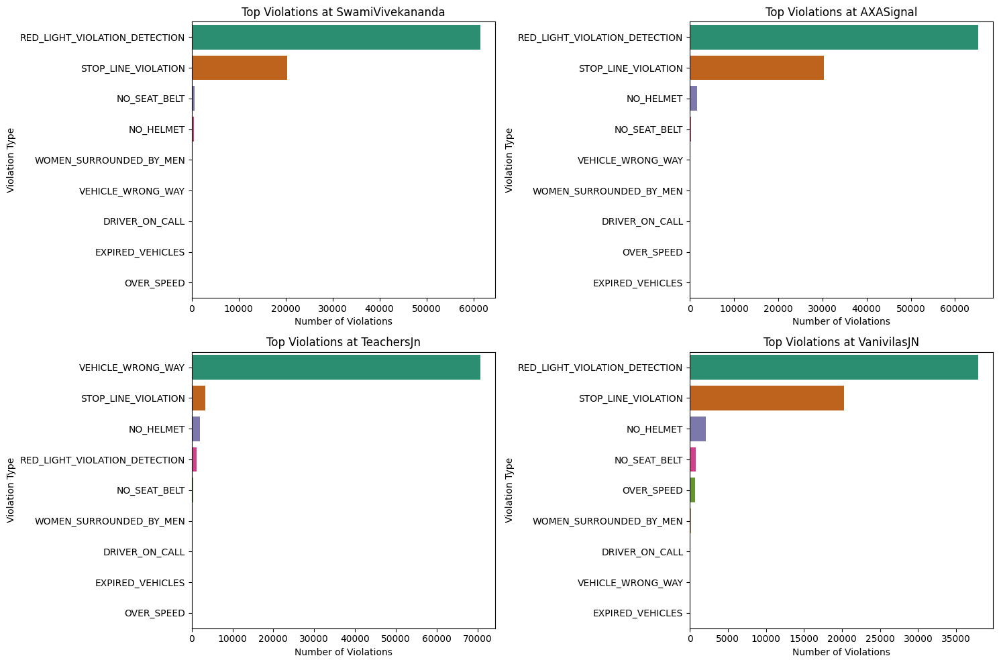

In [89]:
locations = ['SwamiVivekananda', 'AXASignal', 'TeachersJn', 'VanivilasJN']
filtered_df = df1[df1['junctionName'].isin(locations)]

# Group by junction name and alert type, then count the number of violations for each group
location_violation_counts = filtered_df.groupby(['junctionName', 'alertType']).size().unstack(fill_value=0)

# Plotting the data
plt.figure(figsize=(15, 10))

for i, location in enumerate(locations, 1):
    plt.subplot(2, 2, i)
    if location in location_violation_counts.index:
        counts = location_violation_counts.loc[location]
        counts = counts.sort_values(ascending=False)  # Sort violations by frequency
        sns.barplot(x=counts.values, y=counts.index, palette='Dark2')
        plt.title(f'Top Violations at {location}')
        plt.xlabel('Number of Violations')
        plt.ylabel('Violation Type')

plt.tight_layout()
plt.show()

SwamiVivekananda
AXASignal
Teacher’s Junction
Vanivilas Junction
Aishwarya Junction


<Figure size 1200x800 with 0 Axes>

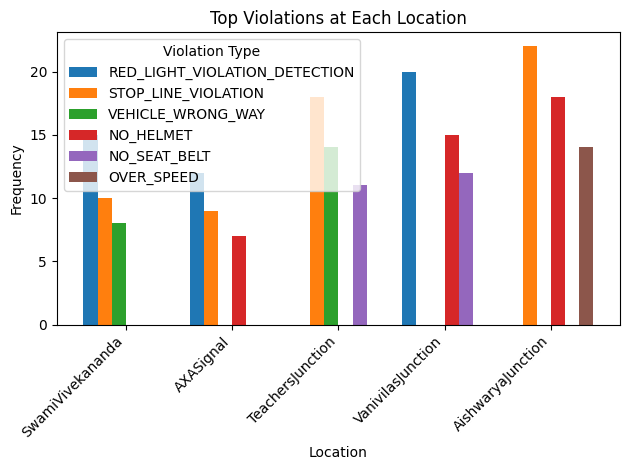

In [88]:
locations = {
    "SwamiVivekananda": {"coordinates": [12.981592, 77.631421], "name": "SwamiVivekananda"},
    "AXASignal": {"coordinates": [12.91602, 77.615204], "name": "AXASignal"},
    "TeachersJunction": {"coordinates": [12.943633, 77.580053], "name": "TeachersJunction"},
    "VanivilasJunction": {"coordinates": [12.948272, 77.576809], "name": "VanivilasJunction"},
    "AishwaryaJunction": {"coordinates": [12.924831, 77.633651], "name": "AishwaryaJunction"}
}

# Prepare data for the top violations at each location
top_violations_data = {
    "SwamiVivekananda": {"RED_LIGHT_VIOLATION_DETECTION": 15, "STOP_LINE_VIOLATION": 10, "VEHICLE_WRONG_WAY": 8},
    "AXASignal": {"RED_LIGHT_VIOLATION_DETECTION": 12, "STOP_LINE_VIOLATION": 9, "NO_HELMET": 7},
    "TeachersJunction": {"STOP_LINE_VIOLATION": 18, "VEHICLE_WRONG_WAY": 14, "NO_SEAT_BELT": 11},
    "VanivilasJunction": {"RED_LIGHT_VIOLATION_DETECTION": 20, "NO_HELMET": 15, "NO_SEAT_BELT": 12},
    "AishwaryaJunction": {"STOP_LINE_VIOLATION": 22, "NO_HELMET": 18, "OVER_SPEED": 14}
}

# Convert the data to a DataFrame
df_top_violations = pd.DataFrame(top_violations_data).T.fillna(0)

# Plotting the grouped bar plot
plt.figure(figsize=(12, 8))
df_top_violations.plot(kind="bar", stacked=False, width=0.8)
plt.title("Top Violations at Each Location")
plt.xlabel("Location")
plt.ylabel("Frequency")
plt.xticks(range(len(df_top_violations.index)), df_top_violations.index, rotation=45, ha="right")
plt.legend(title="Violation Type")
plt.tight_layout()
plt.show()

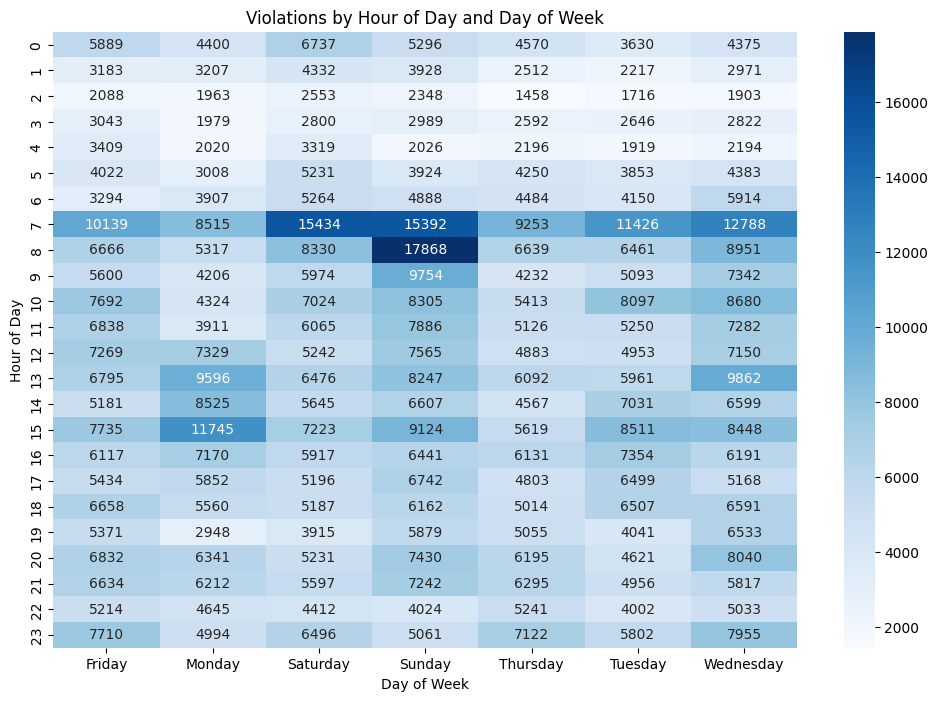

In [92]:
df1['observationDateTime'] = pd.to_datetime(df['observationDateTime'])

# Extract hour of day and day of week
df1['hour'] = df1['observationDateTime'].dt.hour
df1['day_of_week'] = df1['observationDateTime'].dt.day_name()

heatmap_data = df1.groupby(['hour', 'day_of_week']).size().unstack(fill_value=0)

# Plot heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(heatmap_data, cmap='Blues', annot=True, fmt='d')
plt.title('Violations by Hour of Day and Day of Week')
plt.xlabel('Day of Week')
plt.ylabel('Hour of Day')
plt.show()

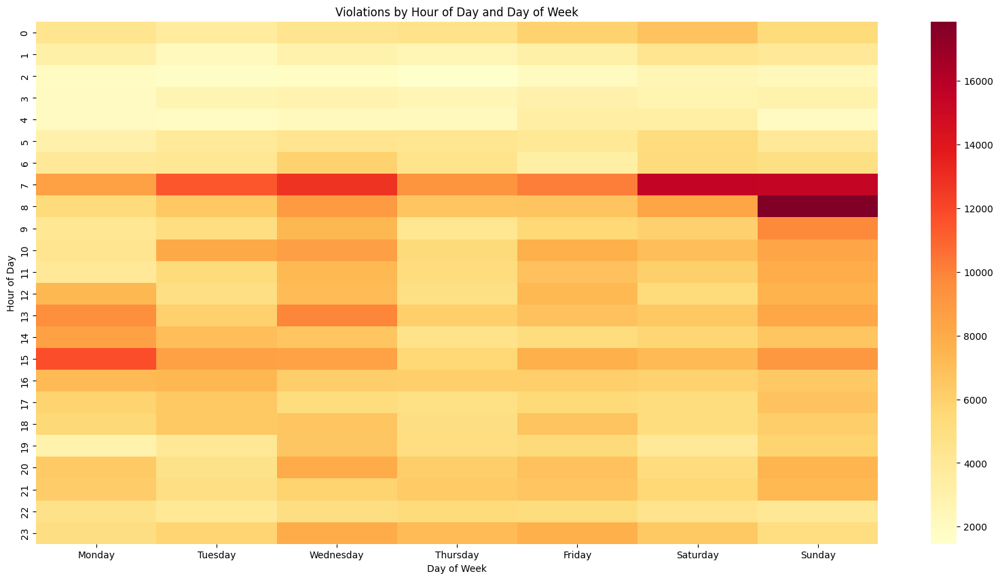

In [97]:
heatmap_data = df1.groupby(['hour', 'day_of_week']).size().unstack(fill_value=0)

# Ensure the days of the week are ordered correctly
heatmap_data = heatmap_data[['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']]

# Plot heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(heatmap_data, cmap='YlOrRd', annot=False)
plt.title('Violations by Hour of Day and Day of Week')
plt.xlabel('Day of Week')
plt.ylabel('Hour of Day')
plt.show()

In [12]:
import folium
from folium.plugins import HeatMapWithTime

# Assuming df1 is your DataFrame and already loaded

# Convert observationDateTime to datetime
df1['observationDateTime'] = pd.to_datetime(df1['observationDateTime'])

# Filter the relevant alert types
filtered_alert_types = ['RED_LIGHT_VIOLATION_DETECTION', 'STOP_LINE_VIOLATION', 'VEHICLE_WRONG_WAY', 'NO_HELMET', 'NO_SEAT_BELT', 'OVER_SPEED']
filtered_df = df1[df1['alertType'].isin(filtered_alert_types)]

# Create a new column 'hour' to represent the hour of the day
filtered_df['hour'] = filtered_df['observationDateTime'].dt.hour

# Function to create the heatmap data
def create_heatmap_data(df, hours):
    heatmap_data = []
    for hour in hours:
        hourly_data = df[df['hour'] == hour]
        heatmap_data.append([[row['location.coordinates'][1], row['location.coordinates'][0], 1] for index, row in hourly_data.iterrows()])
    return heatmap_data

# Define the hours of the day
hours_of_day = list(range(24))

# Create the heatmap data
heatmap_data = create_heatmap_data(filtered_df, hours_of_day)

# Calculate the mean coordinates for centering the map
mean_latitude = filtered_df['location.coordinates'].apply(lambda x: x[1]).mean()
mean_longitude = filtered_df['location.coordinates'].apply(lambda x: x[0]).mean()

# Create the map
map_city = folium.Map(location=[mean_latitude, mean_longitude], zoom_start=12)

# Add the HeatMapWithTime to the map
HeatMapWithTime(heatmap_data, radius=10, auto_play=True, max_opacity=0.8).add_to(map_city)

C:\Users\HP\AppData\Local\Temp\ipykernel_10988\4197272173.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['hour'] = filtered_df['observationDateTime'].dt.hour


C:\Users\HP\AppData\Local\Temp\ipykernel_15004\2068500803.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  swami_df['hour'] = swami_df['observationDateTime'].dt.hour


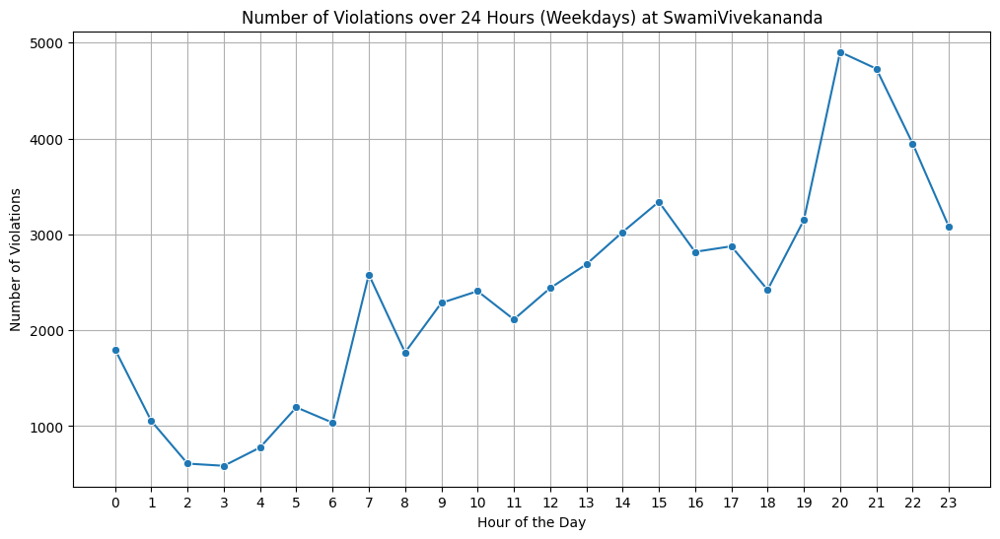

In [30]:
weekdays = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']
weekday_df = df1[df1['dayOfWeek'].isin(weekdays)]

# Filter specifically for SwamiVivekananda
swami_df = weekday_df[weekday_df['junctionName'] == 'SwamiVivekananda']

# Extract the hour from 'observationDateTime'
swami_df['hour'] = swami_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = swami_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for weekdays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours (Weekdays) at SwamiVivekananda')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\1032652372.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  swami_wednesday_df['hour'] = swami_wednesday_df['observationDateTime'].dt.hour


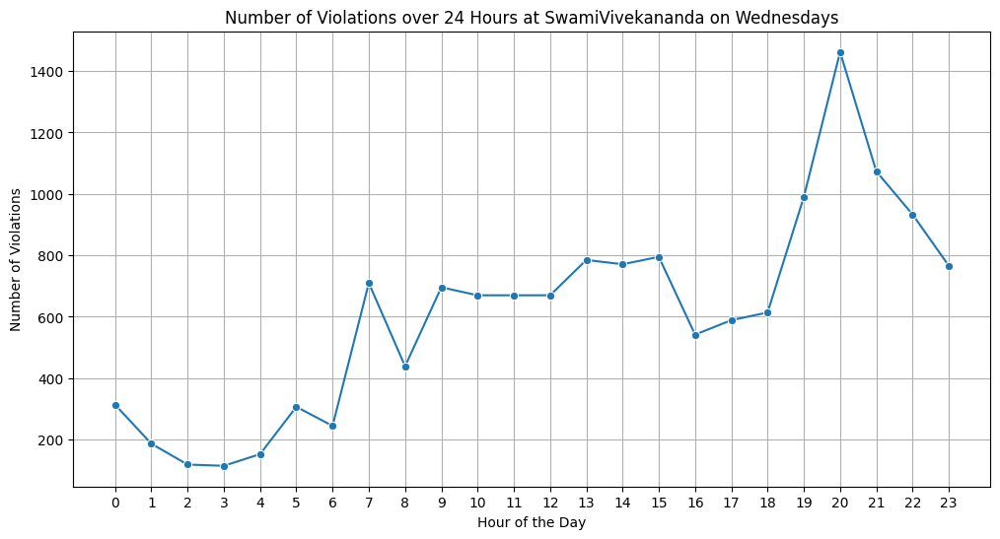

In [31]:
swami_wednesday_df = df1[(df1['junctionName'] == 'SwamiVivekananda') & (df1['dayOfWeek'] == 'Wednesday')]

# Extract the hour from 'observationDateTime'
swami_wednesday_df['hour'] = swami_wednesday_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations_wednesday = swami_wednesday_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for Wednesdays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations_wednesday.index, y=hourly_violations_wednesday.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours at SwamiVivekananda on Wednesdays')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\4150301745.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  axa_df['hour'] = axa_df['observationDateTime'].dt.hour


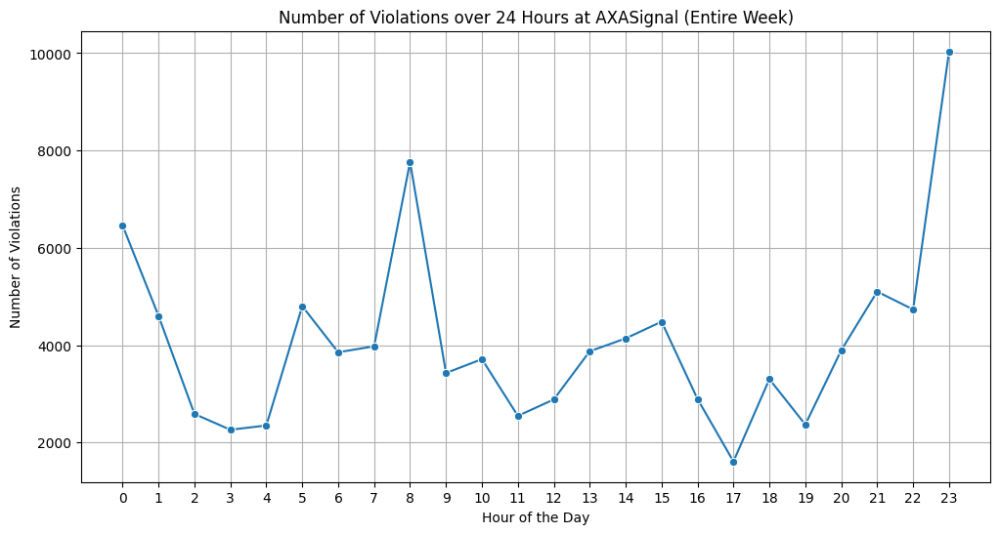

In [33]:
axa_df = df1[df1['junctionName'] == 'AXASignal']

# Extract the hour from 'observationDateTime'
axa_df['hour'] = axa_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = axa_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for the entire week
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours at AXASignal (Entire Week)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\219319928.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  axa_wednesday_df['hour'] = axa_wednesday_df['observationDateTime'].dt.hour


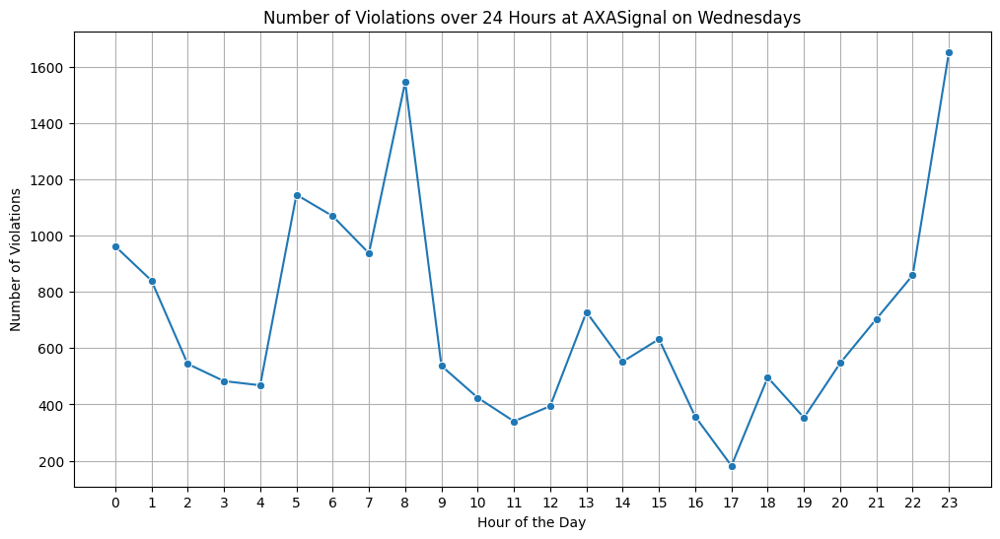

In [32]:
axa_wednesday_df = df1[(df1['junctionName'] == 'AXASignal') & (df1['dayOfWeek'] == 'Wednesday')]

# Extract the hour from 'observationDateTime'
axa_wednesday_df['hour'] = axa_wednesday_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations_wednesday = axa_wednesday_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for Wednesdays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations_wednesday.index, y=hourly_violations_wednesday.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours at AXASignal on Wednesdays')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\3853485752.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  teachers_jn_df['hour'] = teachers_jn_df['observationDateTime'].dt.hour


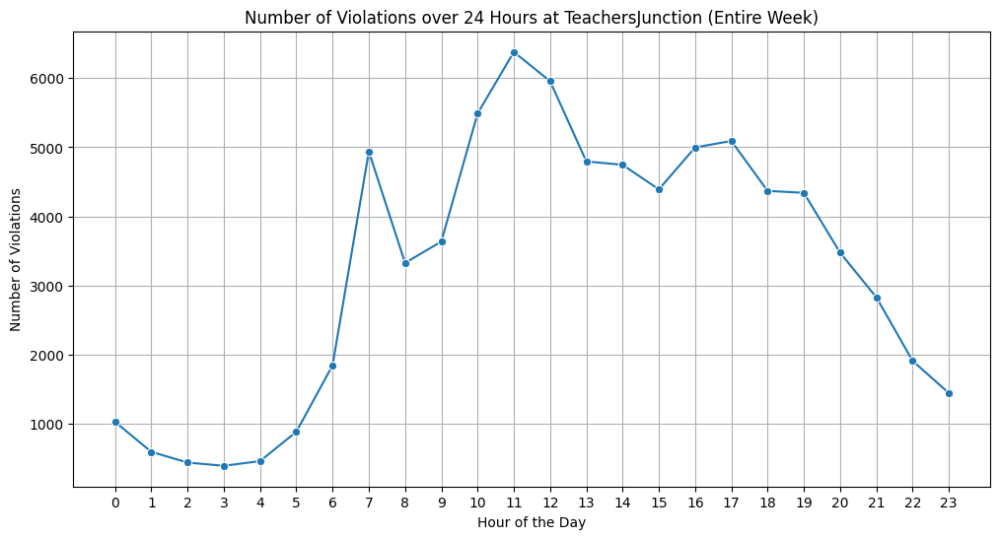

In [35]:
teachers_jn_df = df1[df1['junctionName'] == 'TeachersJn']

# Extract the hour from 'observationDateTime'
teachers_jn_df['hour'] = teachers_jn_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations = teachers_jn_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for the entire week
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations.index, y=hourly_violations.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours at TeachersJunction (Entire Week)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\2970378004.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  teachers_jn_sunday_df['hour'] = teachers_jn_sunday_df['observationDateTime'].dt.hour


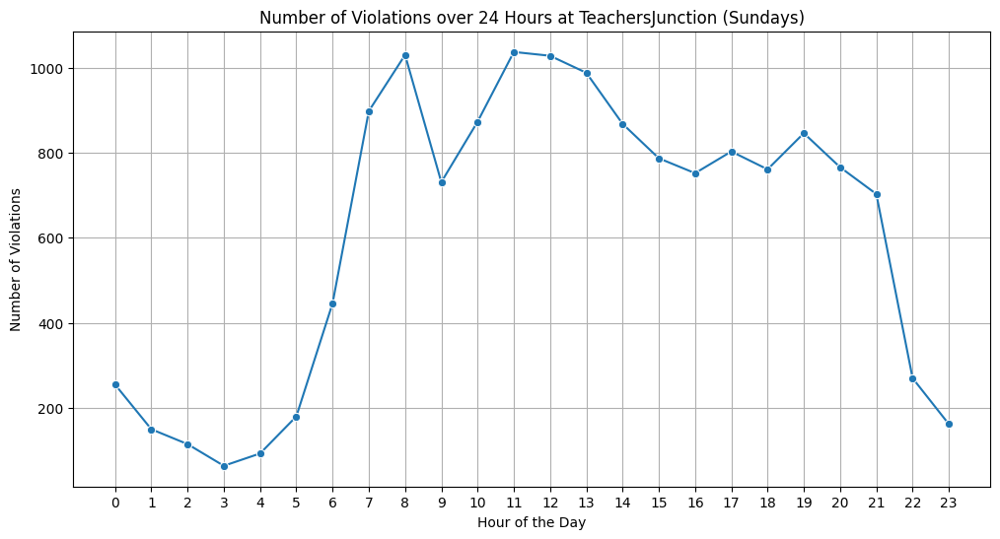

In [37]:
teachers_jn_sunday_df = df1[(df1['junctionName'] == 'TeachersJn') & (df1['dayOfWeek'] == 'Sunday')]

# Extract the hour from 'observationDateTime'
teachers_jn_sunday_df['hour'] = teachers_jn_sunday_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations_sunday = teachers_jn_sunday_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for Sundays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations_sunday.index, y=hourly_violations_sunday.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours at TeachersJunction (Sundays)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()

C:\Users\HP\AppData\Local\Temp\ipykernel_15004\3806934969.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  kormangala_sunday_df['hour'] = kormangala_sunday_df['observationDateTime'].dt.hour


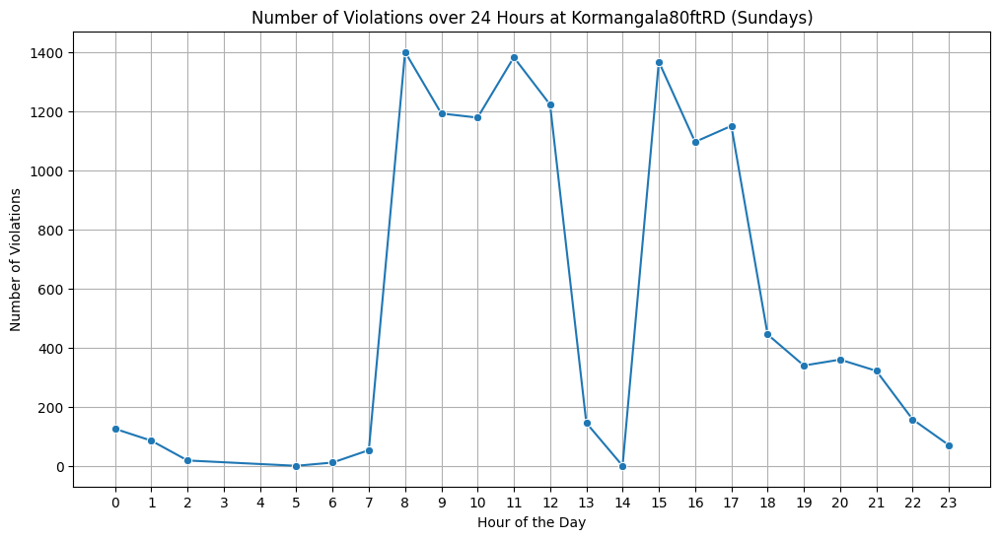

In [42]:
kormangala_sunday_df = df1[(df1['junctionName'] == 'Kormangala80ftRD') & (df1['dayOfWeek'] == 'Sunday')]

# Extract the hour from 'observationDateTime'
kormangala_sunday_df['hour'] = kormangala_sunday_df['observationDateTime'].dt.hour

# Group by hour and count the number of violations for each hour
hourly_violations_sunday = kormangala_sunday_df.groupby('hour').size()

# Plotting the time series of violations over 24 hours for Sundays
plt.figure(figsize=(12, 6))
sns.lineplot(x=hourly_violations_sunday.index, y=hourly_violations_sunday.values, marker='o')
plt.xlabel('Hour of the Day')
plt.ylabel('Number of Violations')
plt.title('Number of Violations over 24 Hours at Kormangala80ftRD (Sundays)')
plt.xticks(range(0, 24))
plt.grid(True)
plt.show()